### INFO 623 PROJECT CODE
#### Vuthej (vv334)
#### Likhil (lkr46)

### AIRWAYS TRANSPORT NETWORK

In [1]:
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
from pprint import pprint
from networkx.algorithms import community

In [ ]:
infile = "flights-test1.txt"
graphtype = nx.DiGraph()

G1 = nx.read_edgelist(infile, create_using = graphtype, nodetype = int)

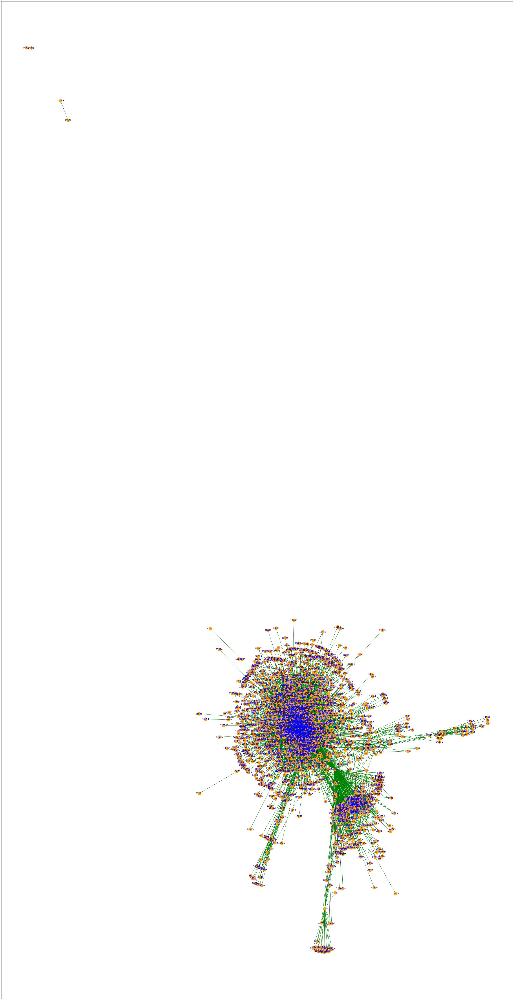

In [111]:
plt.figure(figsize = (50,100))
nx.draw_networkx(G1, node_color = 'orange', font_color = 'blue', edge_color = 'green')

In [6]:
G1_socio_matrix = nx.to_pandas_adjacency(G1)

# G1_socio_matrix = G1_matrix.style.applymap(lambda x: 'font-weight : bold' if x == 1 else '')

In [98]:
G1_socio_matrix

,10005,10184,10247,11214,11630,10009,10056,10170,13863,13934,...,16614,16619,16650,16821,16823,16837,16847,16852,16864,16873
10005,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10184,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10247,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11214,1.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11630,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16837,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16847,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16852,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16864,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [7]:
G1_degree = G1.degree()
print("\nNodes and Degrees : ", G1_degree, "\n")


Nodes and Degrees :  [(10005, 6), (10184, 19), (10247, 30), (11214, 14), (11630, 243), (10009, 7), (10056, 54), (10170, 62), (13863, 13), (13934, 11), (10010, 6), (10154, 115), (12222, 64), (12944, 9), (13450, 3), (10011, 15), (10661, 24), (11399, 18), (11869, 25), (12211, 11), (12745, 8), (12889, 452), (14081, 67), (10014, 2), (10016, 4), (12184, 69), (10017, 4), (10043, 4), (10033, 4), (10299, 566), (14709, 59), (10039, 2), (10040, 2), (10042, 2), (10044, 2), (10063, 1), (10088, 2), (10100, 2), (10278, 5), (10556, 1), (11299, 5), (12509, 1), (12705, 4), (12712, 4), (12721, 18), (12743, 4), (12771, 3), (12772, 8), (12782, 3), (12785, 4), (12854, 4), (12869, 2), (15091, 6), (15446, 6), (15836, 1), (10065, 2), (10078, 1), (10085, 2), (10112, 2), (13970, 94), (10127, 10), (10721, 480), (11193, 311), (12892, 657), (14100, 450), (15167, 583), (10135, 114), (10194, 124), (10397, 609), (10434, 43), (10469, 21), (10529, 250), (10590, 257), (10693, 389), (10821, 398), (11042, 288), (11057, 45

In [8]:
degrees = [degree[1] for degree in G1_degree]

mean_degree = sum(degrees) / len(degrees)
print("\n1.A) Mean Degree : ", mean_degree, "\n")

deviation = [((degree[1] - mean_degree) ** 2) for degree in G1_degree]
variance_of_degree = sum(deviation) / len(deviation)

print("     Variance of Degree : ", variance_of_degree, "\n")

# print("     Degree Distribution : P1 = 1/6, P2 = 2/6, P3 = 3/6\n")

print("1.B) Density of Network : ", (2 * len(G1.edges())) / (len(G1.nodes()) * (len(G1.nodes()) - 1)), "\n")


1.A) Mean Degree :  20.96045197740113 

     Variance of Degree :  2132.613227941591 

1.B) Density of Network :  0.01077104418160387 



In [44]:
print("\nStandardized Degree Centrality : The value obtained by dividing 'degree centrality' by 'g-1' where g is the number of nodes in the network.")
print("\nNodes with Standardized Degree Centrality\n")
degree_centrality = nx.degree_centrality(G1)
degree_centrality


Standardized Degree Centrality : The value obtained by dividing 'degree centrality' by 'g-1' where g is the number of nodes in the network.

Nodes with Standardized Degree Centrality



{10140: 0.07348406988694758,
 11413: 0.012846865364850977,
 11711: 0.009249743062692703,
 10194: 0.047276464542651594,
 12278: 0.06423432682425488,
 12896: 0.06115107913669065,
 13158: 0.045734840698869475,
 15370: 0.06474820143884892,
 10299: 0.18705035971223022,
 11555: 0.03494347379239466,
 11630: 0.07810894141829394,
 12184: 0.023638232271325797,
 10666: 0.02158273381294964,
 11762: 0.007708119218910586,
 14747: 0.12024665981500514,
 11050: 0.0035971223021582736,
 11198: 0.0030832476875642346,
 14057: 0.1104830421377184,
 11470: 0.005652620760534429,
 11884: 0.06526207605344296,
 16101: 0.012332990750256938,
 11588: 0.009763617677286743,
 11603: 0.03391572456320658,
 11695: 0.01079136690647482,
 12132: 0.0041109969167523125,
 13785: 0.009763617677286743,
 14107: 0.11819116135662898,
 12018: 0.0035971223021582736,
 11775: 0.047790339157245634,
 14457: 0.019013360739979446,
 12956: 0.0035971223021582736,
 13127: 0.007194244604316547,
 13546: 0.009763617677286743,
 14054: 0.0107913669

In [46]:
print("\nStandardized Closeness Centrality : For a network if 'g' nodes, this value is the product of 'g-1' with reciprocal of the summation of geodesic distance from that node to the rest of the nodes in the network.")
print("\nNodes with Closeness Centrality\n")
closeness_centrality = nx.closeness_centrality(G1)
closeness_centrality


Standardized Closeness Centrality : For a network if 'g' nodes, this value is the product of 'g-1' with reciprocal of the summation of geodesic distance from that node to the rest of the nodes in the network.

Nodes with Closeness Centrality



{10140: 0.4447012900398884,
 11413: 0.39191268392190765,
 11711: 0.3885341263018912,
 10194: 0.4318200138132428,
 12278: 0.4569696349902932,
 12896: 0.44408987671719374,
 13158: 0.41543584608656664,
 15370: 0.42687405770789283,
 10299: 0.5058752863466023,
 11555: 0.3906487042922462,
 11630: 0.41181645176239556,
 12184: 0.3724789971158627,
 10666: 0.4019929935685197,
 11762: 0.35520678555605456,
 14747: 0.4880403480216151,
 11050: 0.3465679939187828,
 11198: 0.32819783607008185,
 14057: 0.47875697183642135,
 11470: 0.35690759152740953,
 11884: 0.4485091927780221,
 16101: 0.3739163075427038,
 11588: 0.3598901062198391,
 11603: 0.41975486722846733,
 11695: 0.37326814753348103,
 12132: 0.3481243438106401,
 13785: 0.3869052150117456,
 14107: 0.4871815540457098,
 12018: 0.3400014424550585,
 11775: 0.4069735871469621,
 14457: 0.3865964935156261,
 12956: 0.3598901062198391,
 13127: 0.35585901982993634,
 13546: 0.3793322023867359,
 14054: 0.3738441786253537,
 14252: 0.3875241395708525,
 12003: 

In [48]:
print("\nStandardized Betweenness Centrality : For a network with 'g' nodes, this is the value obtained by multiplying the 'Betweenness Centrality' with 2 and then dividing it by the product of 'g-1' and 'g-2').")
print("\nNodes with Standardized Betweenness Centrality\n")
betweenness_centrality = nx.betweenness_centrality(G1, normalized = True)

betweenness_centrality


Standardized Betweenness Centrality : For a network with 'g' nodes, this is the value obtained by multiplying the 'Betweenness Centrality' with 2 and then dividing it by the product of 'g-1' and 'g-2').

Nodes with Standardized Betweenness Centrality



{10140: 0.006738461411648496,
 11413: 0.00037253226936527685,
 11711: 0.0003003782167546986,
 10194: 0.0031197177635791853,
 12278: 0.002851914800151789,
 12896: 0.0053585323065527815,
 13158: 0.00020196729335271758,
 15370: 0.0020860881816014754,
 10299: 0.20882951965753976,
 11555: 0.005678618741284143,
 11630: 0.04404543994945769,
 12184: 0.008368941156174863,
 10666: 0.0007203506399323143,
 11762: 0.0007222172467064197,
 14747: 0.03008561480384001,
 11050: 4.480000734391674e-07,
 11198: 3.2313533188636373e-06,
 14057: 0.012441608070802645,
 11470: 1.3259595885585546e-05,
 11884: 0.0032796183932488295,
 16101: 0.0012206699980942296,
 11588: 0.00012890036378643692,
 11603: 0.0012067645998770843,
 11695: 0.0007879368412084118,
 12132: 1.4247726177058448e-05,
 13785: 0.00026017808222379837,
 14107: 0.01609591508135246,
 12018: 3.8035954079043096e-06,
 11775: 0.0025034144555014155,
 14457: 0.0002701861627257398,
 12956: 1.5099817725032209e-05,
 13127: 2.982641432254626e-05,
 13546: 0.00

In [2]:
inp=pd.read_csv("airline_edges.csv")
inp1=inp[['ORIGIN_AIRPORT_ID','DEST_AIRPORT_ID']]
inp1["conn"]=1
inp1 = inp1.groupby(['ORIGIN_AIRPORT_ID','DEST_AIRPORT_ID']).size().reset_index(name='counts')

inp1.to_csv("flights-test1.csv",index=False,header=None)

C:\Users\likhi\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [3]:
# inp1['ORIGIN_AIRPORT_ID'].count()
inp1[(inp1['ORIGIN_AIRPORT_ID']==10140) & (inp1['DEST_AIRPORT_ID']==11413)]

,ORIGIN_AIRPORT_ID,DEST_AIRPORT_ID,counts
186,10140,11413,18


In [4]:
infile = "flights-test1.csv"
graphtype = nx.DiGraph()

# G1 = nx.read_edgelist(infile, create_using = graphtype, nodetype = int, delimiter=',')

G1 = nx.from_pandas_edgelist(inp1,'ORIGIN_AIRPORT_ID','DEST_AIRPORT_ID', edge_attr='counts',create_using = graphtype)


C:\Users\likhi\Anaconda3\lib\site-packages\networkx\drawing\nx_pylab.py:676: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if cb.iterable(node_size):  # many node sizes


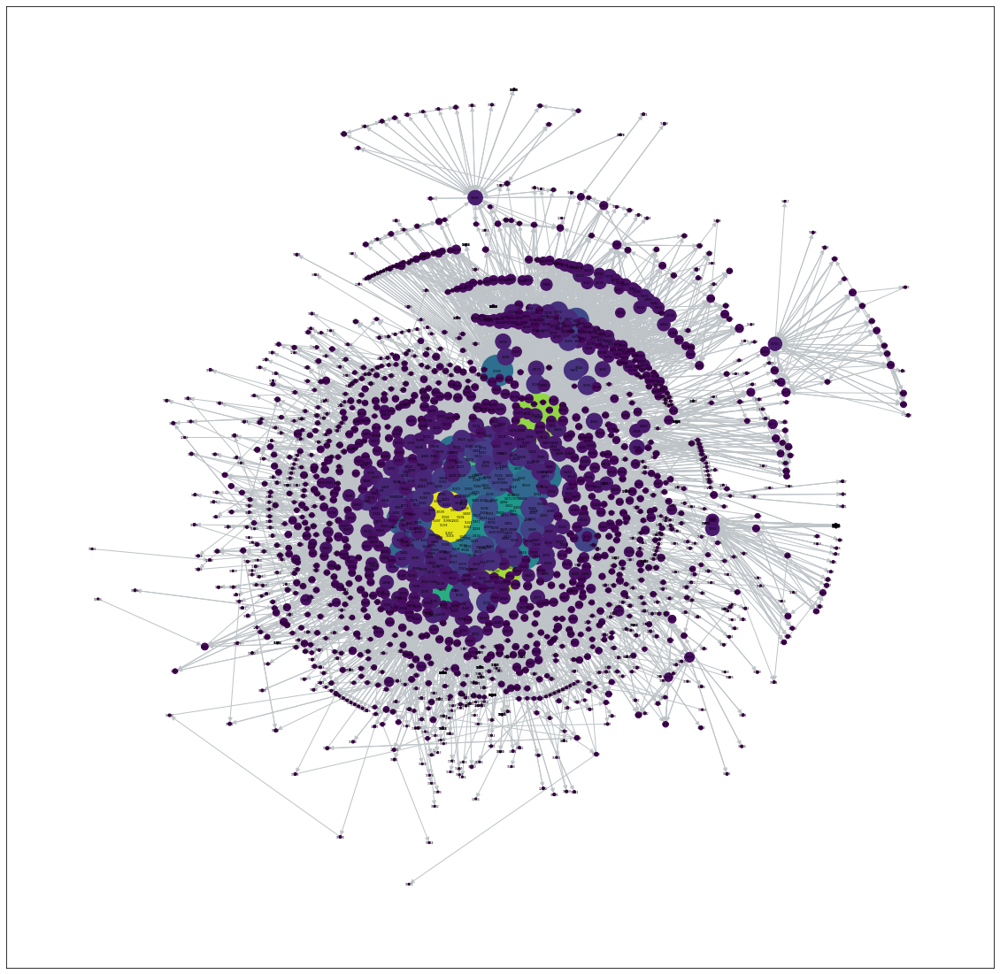

In [109]:
# color = [20000.0 * G_nodes.degree(v) for v in G1_degree]
# size =  [v * 10000 for v in df_centrality.values()]
pos = nx.kamada_kawai_layout(G1)
degCent = nx.degree_centrality(G1)
node_color = [20000.0 * G1.degree(v) for v in G1]
node_size =  [v * 10000 for v in degCent.values()]
plt.figure(figsize=(20,20))
nx.draw_networkx(G1, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size,edge_color="#BDC3C7" ,font_size=3)

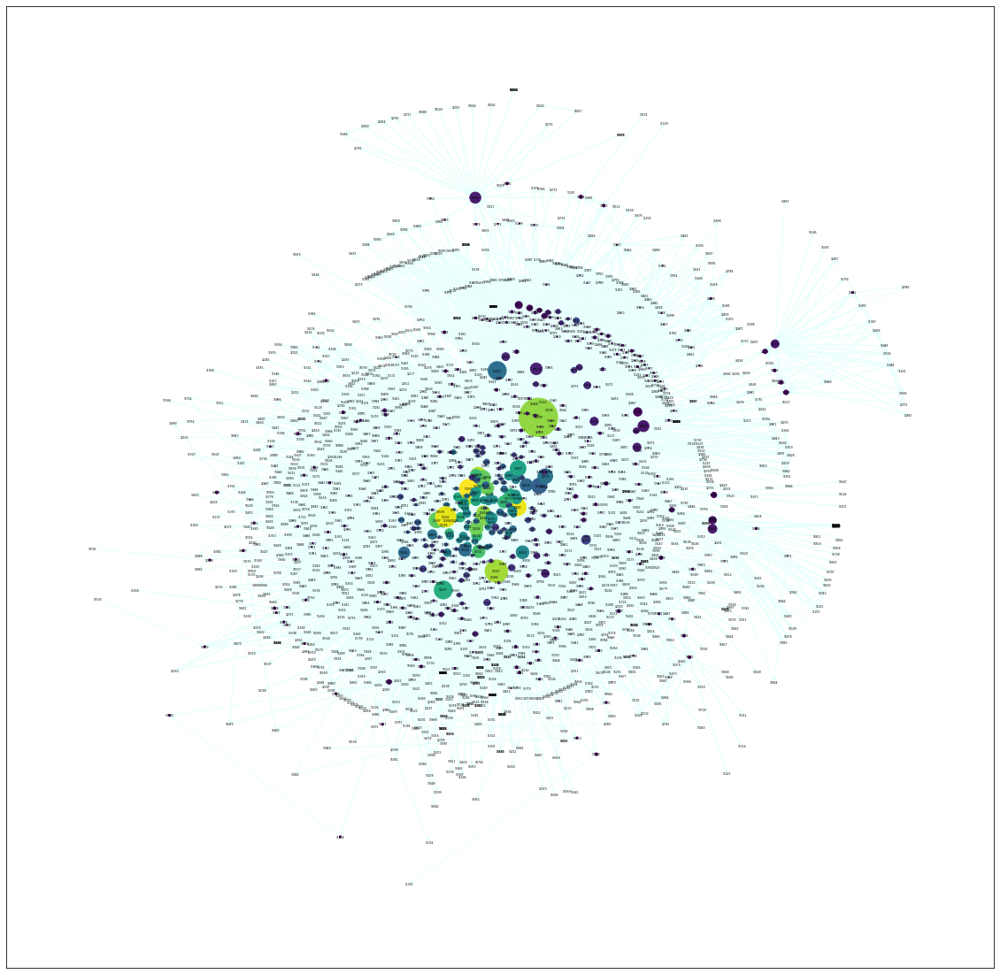

In [110]:
pos = nx.kamada_kawai_layout(G1)
betCent = nx.betweenness_centrality(G1,normalized=True)
node_color = [20000.0 * G1.degree(v) for v in G1]
node_size =  [v * 10000 for v in betCent.values()]
plt.figure(figsize=(20,20))
nx.draw_networkx(G1, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size,edge_color="#e8fffd" ,font_size=3)

In [55]:
# betCent = nx.betweeness_centrality(G1)
# [G1.degree(v) for v in G1]
# group_betweenness_centrality

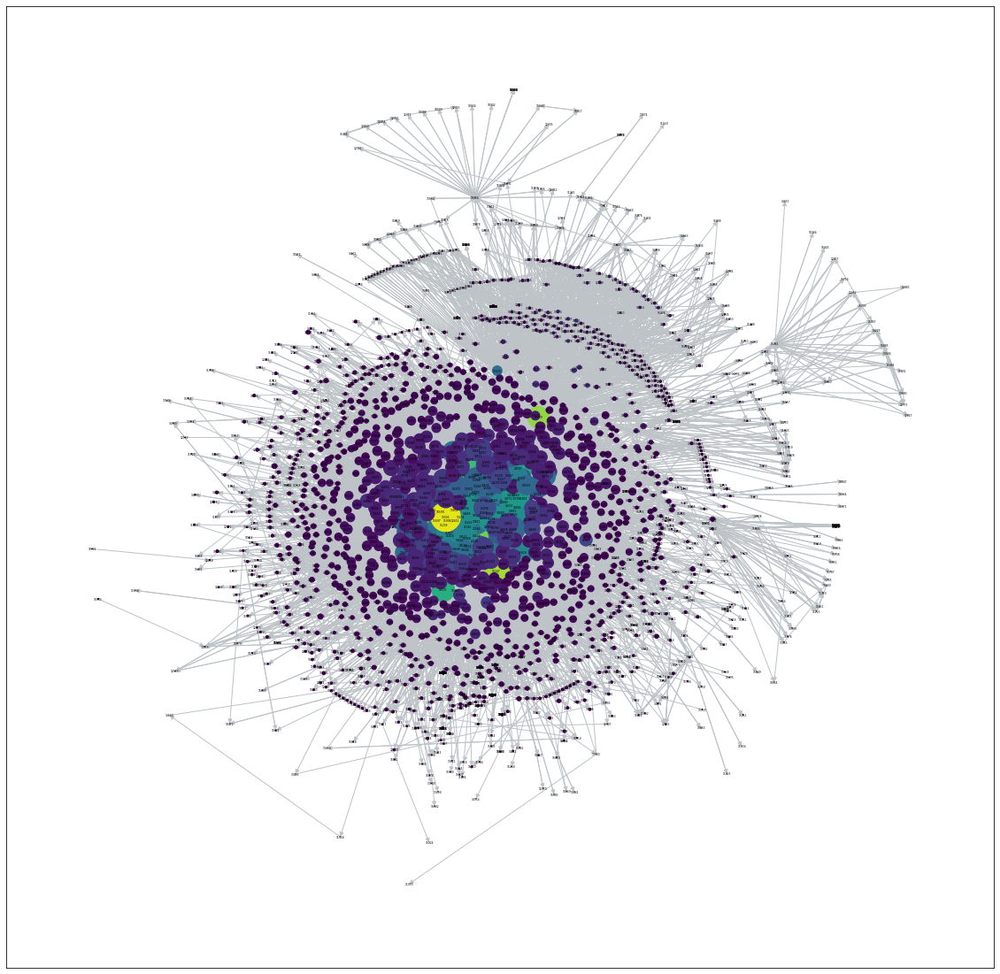

In [111]:

pos = nx.kamada_kawai_layout(G1)
betCent = nx.eigenvector_centrality(G1)
node_color = [20000.0 * G1.degree(v) for v in G1]
node_size =  [v * 10000 for v in betCent.values()]
plt.figure(figsize=(20,20))
nx.draw_networkx(G1, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size,edge_color="#BDC3C7" ,font_size=3)

C:\Users\likhi\Anaconda3\lib\site-packages\networkx\drawing\nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):
C:\Users\likhi\Anaconda3\lib\site-packages\networkx\drawing\nx_pylab.py:676: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if cb.iterable(node_size):  # many node sizes


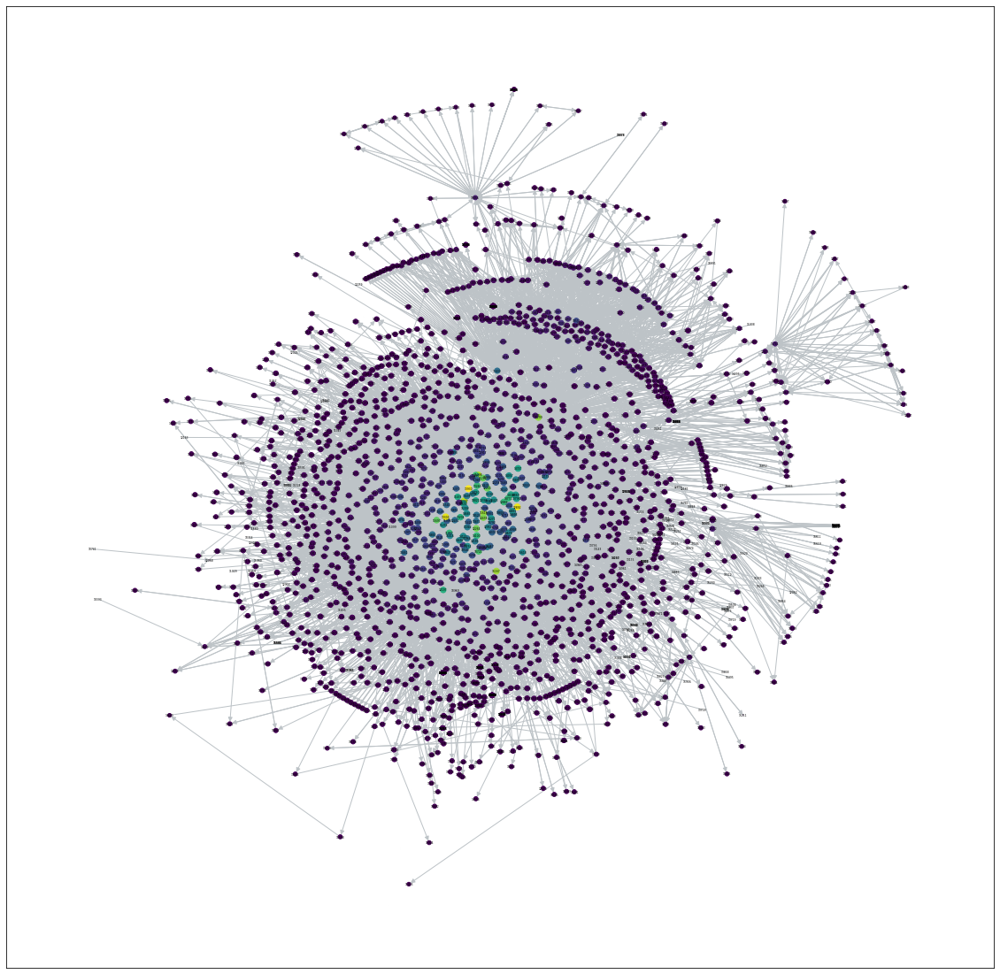

In [7]:

pos = nx.kamada_kawai_layout(G1)
betCent = nx.closeness_centrality(G1)
node_color = [20000.0 * G1.degree(v) for v in G1]
node_size =  [v * 100 for v in betCent.values()]
plt.figure(figsize=(20,20))
nx.draw_networkx(G1, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size,edge_color="#BDC3C7" ,font_size=3)

In [6]:
# inp=pd.read_csv("airline_edges.csv")
inp=pd.read_csv("airline_edges.csv")
m_1=inp[inp["MONTH"].isin([1,2,3])]
grp1=m_1[['ORIGIN_AIRPORT_ID','DEST_AIRPORT_ID']]
grp1["conn"]=1
grp1 = grp1.groupby(['ORIGIN_AIRPORT_ID','DEST_AIRPORT_ID']).size().reset_index(name='counts')
grp1.head()
# grp1.to_csv("flights-group1.csv",index=False,header=None)

C:\Users\likhi\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


,ORIGIN_AIRPORT_ID,DEST_AIRPORT_ID,counts
0,10005,11630,1
1,10011,10011,3
2,10011,10661,2
3,10011,11869,1
4,10011,12889,1


In [7]:
# infile = "flights-group1.csv"
graphtype = nx.DiGraph()

# G1 = nx.read_edgelist(infile, create_using = graphtype, nodetype = int, delimiter=',')

Gr1 = nx.from_pandas_edgelist(grp1,'ORIGIN_AIRPORT_ID','DEST_AIRPORT_ID', edge_attr='counts',create_using = graphtype)


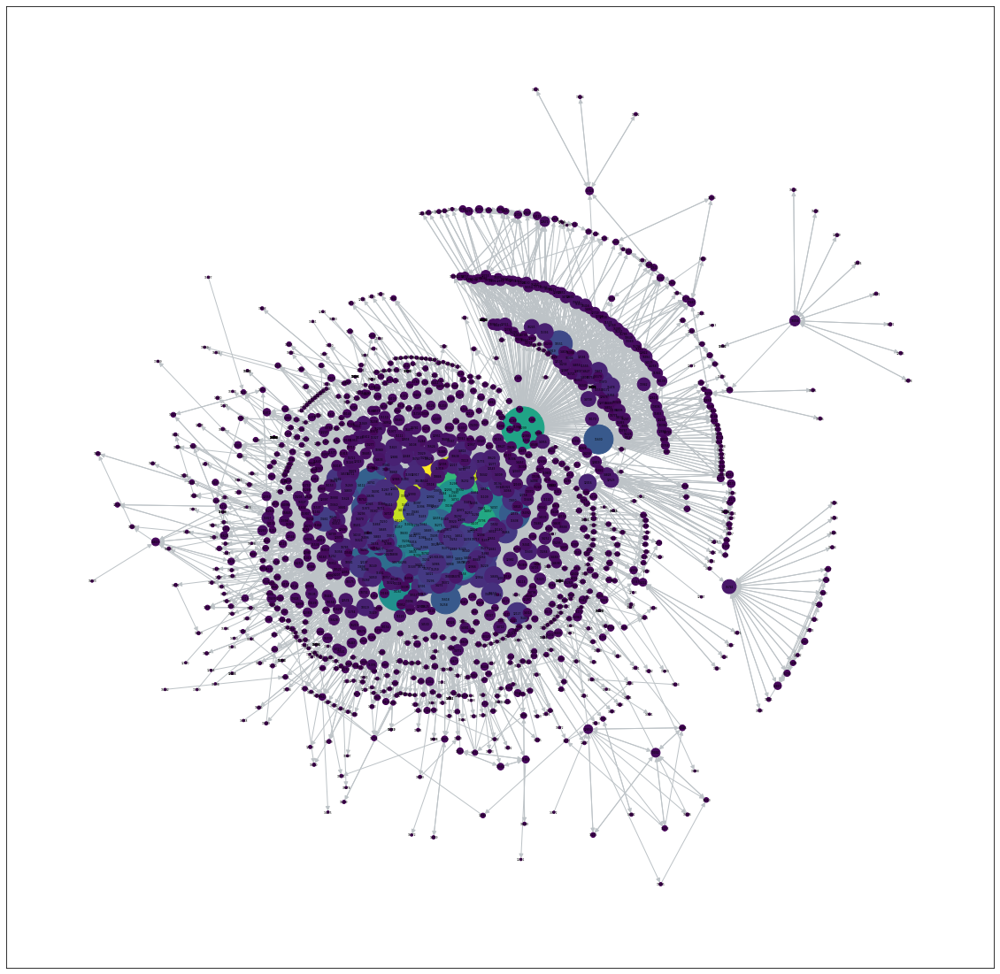

In [113]:
pos = nx.kamada_kawai_layout(Gr1)
degCent = nx.degree_centrality(Gr1)
node_color = [20000.0 * Gr1.degree(v) for v in Gr1]
node_size =  [v * 10000 for v in degCent.values()]
plt.figure(figsize=(20,20))
nx.draw_networkx(Gr1, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size,edge_color="#BDC3C7" ,font_size=3)

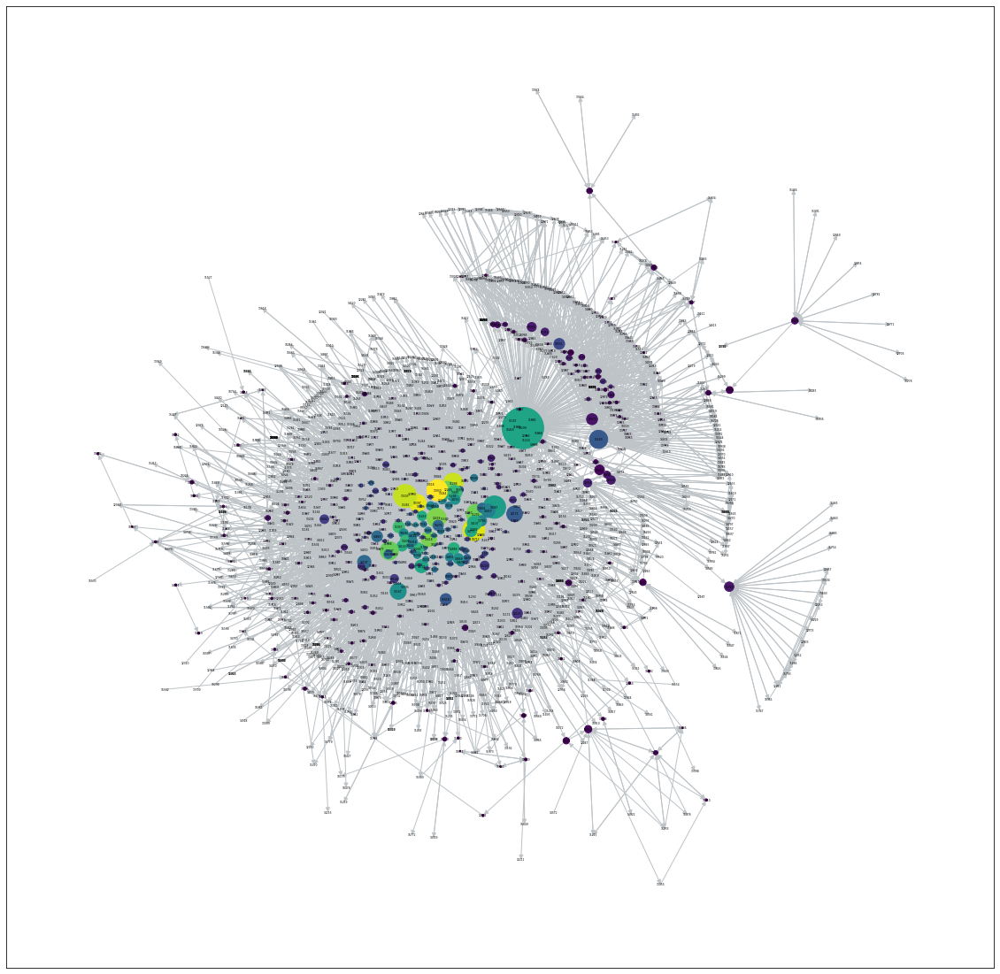

In [114]:
pos = nx.kamada_kawai_layout(Gr1)
degCent = nx.betweenness_centrality(Gr1,normalized=True)
node_color = [20000.0 * Gr1.degree(v) for v in Gr1]
node_size =  [v * 10000 for v in degCent.values()]
plt.figure(figsize=(20,20))
nx.draw_networkx(Gr1, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size,edge_color="#BDC3C7" ,font_size=3)

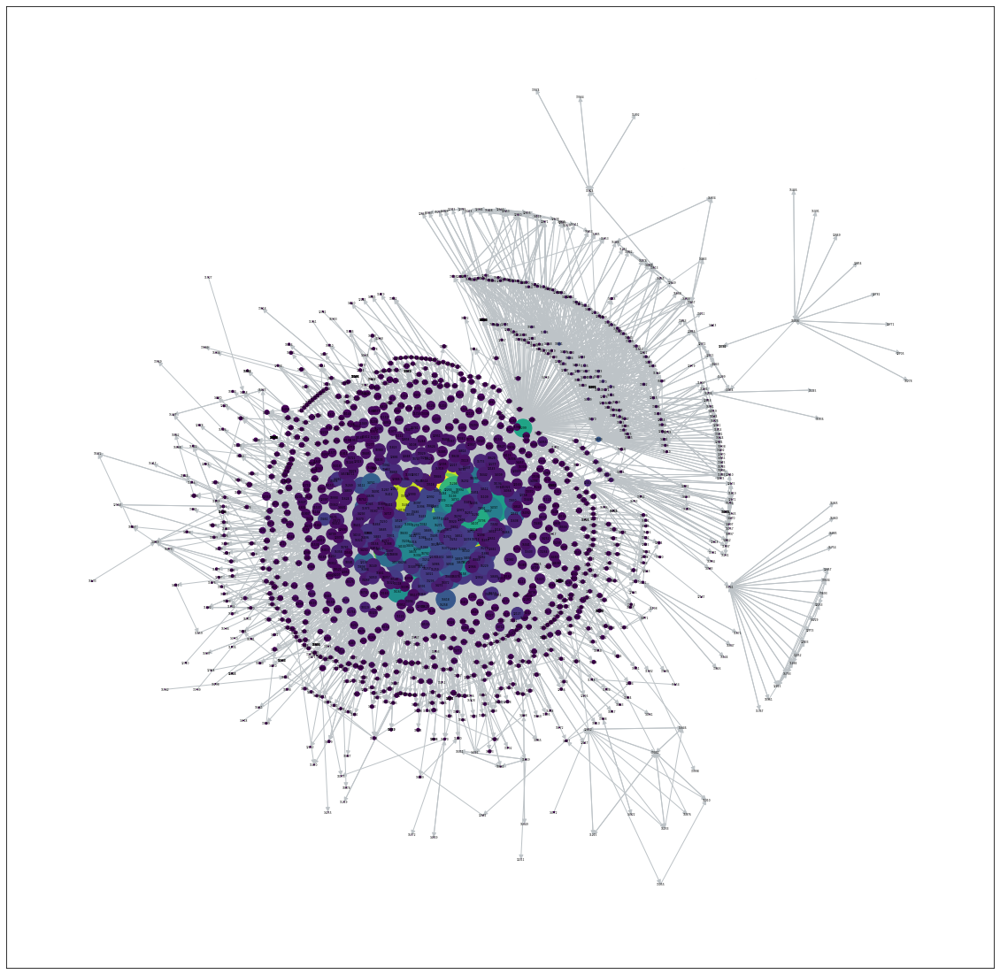

In [115]:
pos = nx.kamada_kawai_layout(Gr1)
degCent = nx.eigenvector_centrality(Gr1)
node_color = [20000.0 * Gr1.degree(v) for v in Gr1]
node_size =  [v * 10000 for v in degCent.values()]
plt.figure(figsize=(20,20))
nx.draw_networkx(Gr1, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size,edge_color="#BDC3C7" ,font_size=3)

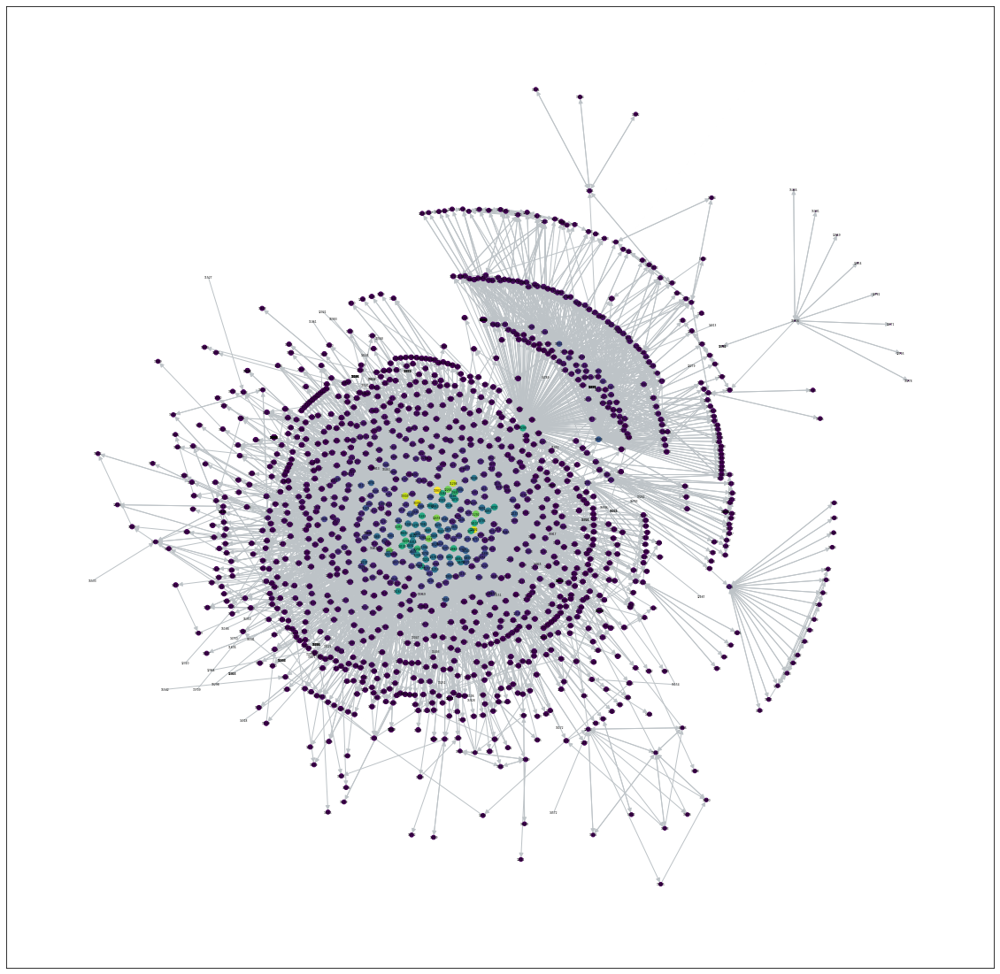

In [10]:
pos = nx.kamada_kawai_layout(Gr1)
degCent = nx.closeness_centrality(Gr1)
node_color = [20000.0 * Gr1.degree(v) for v in Gr1]
node_size =  [v * 100 for v in degCent.values()]
plt.figure(figsize=(20,20))
nx.draw_networkx(Gr1, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size,edge_color="#BDC3C7" ,font_size=3)

In [8]:
# inp=pd.read_csv("airline_edges.csv")
inp=pd.read_csv("airline_edges.csv")
m_2=inp[inp["MONTH"].isin([4,5,6])]
grp2=m_2[['ORIGIN_AIRPORT_ID','DEST_AIRPORT_ID']]
grp2["conn"]=1
grp2 = grp2.groupby(['ORIGIN_AIRPORT_ID','DEST_AIRPORT_ID']).size().reset_index(name='counts')
grp2.head()
# grp1.to_csv("flights-group1.csv",index=False,header=None)

C:\Users\likhi\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


,ORIGIN_AIRPORT_ID,DEST_AIRPORT_ID,counts
0,10005,11214,1
1,10005,11630,1
2,10009,10170,2
3,10009,13934,1
4,10011,10011,3


In [9]:
# infile = "flights-group1.csv"
graphtype = nx.DiGraph()

# G1 = nx.read_edgelist(infile, create_using = graphtype, nodetype = int, delimiter=',')

Gr2 = nx.from_pandas_edgelist(grp2,'ORIGIN_AIRPORT_ID','DEST_AIRPORT_ID', edge_attr='counts',create_using = graphtype)


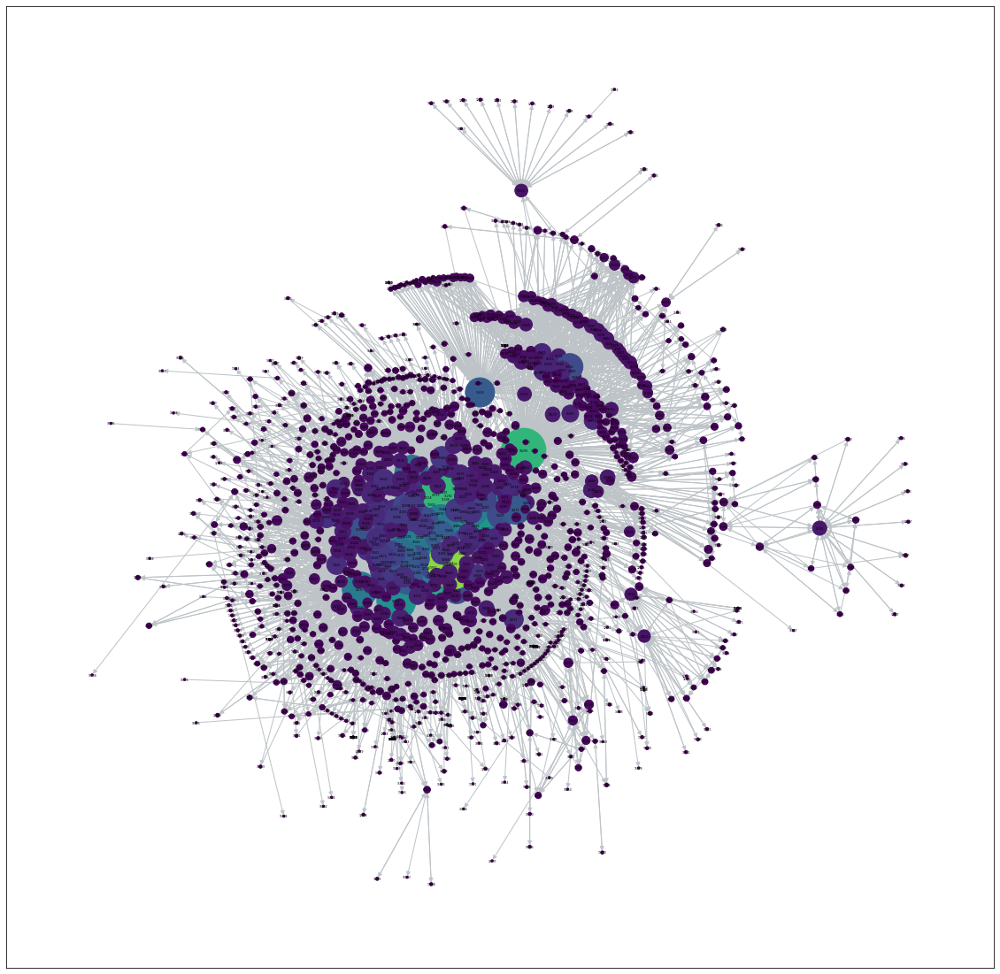

In [117]:
pos = nx.kamada_kawai_layout(Gr2)
degCent = nx.degree_centrality(Gr2)
node_color = [20000.0 * Gr2.degree(v) for v in Gr2]
node_size =  [v * 10000 for v in degCent.values()]
plt.figure(figsize=(20,20))
nx.draw_networkx(Gr2, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size,edge_color="#BDC3C7" ,font_size=3)

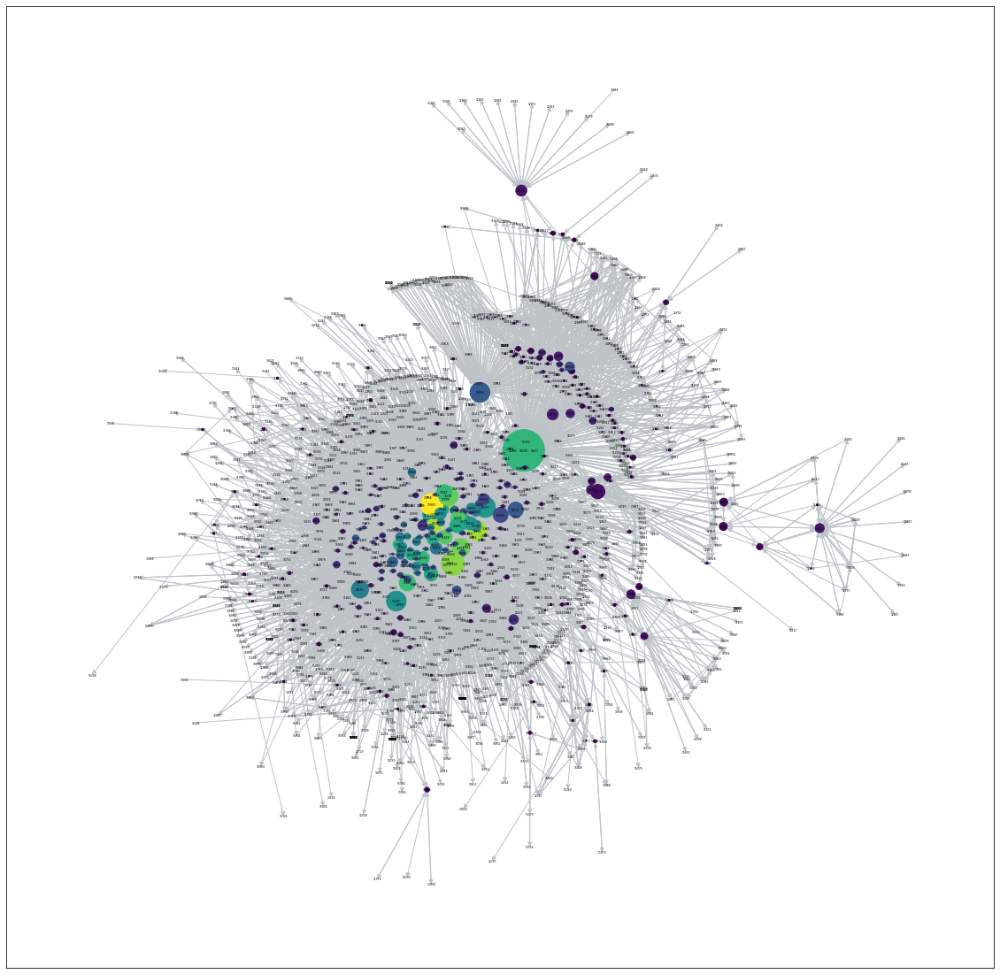

In [118]:
pos = nx.kamada_kawai_layout(Gr2)
degCent = nx.betweenness_centrality(Gr2,normalized=True)
node_color = [20000.0 * Gr2.degree(v) for v in Gr2]
node_size =  [v * 10000 for v in degCent.values()]
plt.figure(figsize=(20,20))
nx.draw_networkx(Gr2, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size,edge_color="#BDC3C7" ,font_size=3)

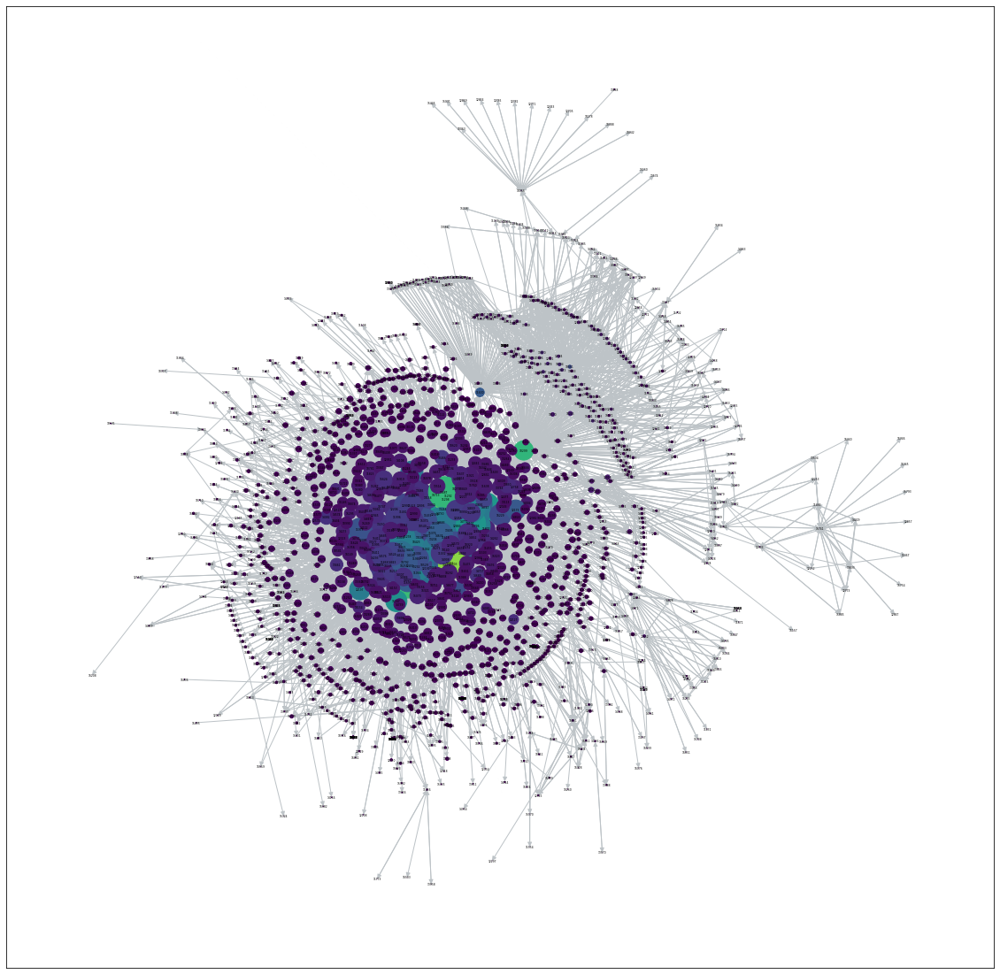

In [119]:
pos = nx.kamada_kawai_layout(Gr2)
degCent = nx.eigenvector_centrality(Gr2)
node_color = [20000.0 * Gr2.degree(v) for v in Gr2]
node_size =  [v * 10000 for v in degCent.values()]
plt.figure(figsize=(20,20))
nx.draw_networkx(Gr2, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size,edge_color="#BDC3C7" ,font_size=3)

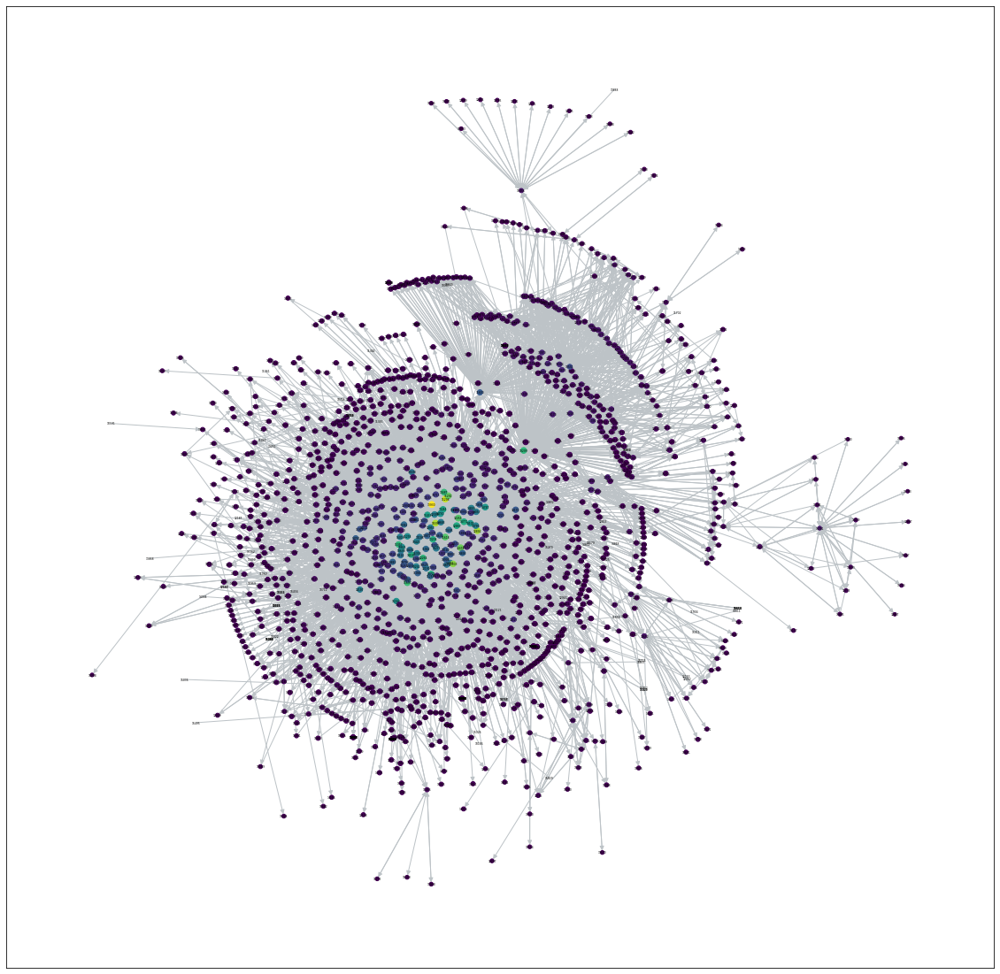

In [17]:
pos = nx.kamada_kawai_layout(Gr2)
degCent = nx.closeness_centrality(Gr2)
node_color = [20000.0 * Gr2.degree(v) for v in Gr2]
node_size =  [v * 100 for v in degCent.values()]
plt.figure(figsize=(20,20))
nx.draw_networkx(Gr2, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size,edge_color="#BDC3C7" ,font_size=3)

In [10]:
# inp=pd.read_csv("airline_edges.csv")
inp=pd.read_csv("airline_edges.csv")
m_3=inp[inp["MONTH"].isin([7,8,9,10])]
grp3=m_3[['ORIGIN_AIRPORT_ID','DEST_AIRPORT_ID']]
grp3["conn"]=1
grp3 = grp3.groupby(['ORIGIN_AIRPORT_ID','DEST_AIRPORT_ID']).size().reset_index(name='counts')
grp3.head()
# grp1.to_csv("flights-group1.csv",index=False,header=None)

C:\Users\likhi\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


,ORIGIN_AIRPORT_ID,DEST_AIRPORT_ID,counts
0,10005,10184,1
1,10005,10247,1
2,10005,11630,4
3,10009,10056,1
4,10009,10170,2


In [11]:
# infile = "flights-group1.csv"
graphtype = nx.DiGraph()

# G1 = nx.read_edgelist(infile, create_using = graphtype, nodetype = int, delimiter=',')

Gr3 = nx.from_pandas_edgelist(grp3,'ORIGIN_AIRPORT_ID','DEST_AIRPORT_ID', edge_attr='counts',create_using = graphtype)


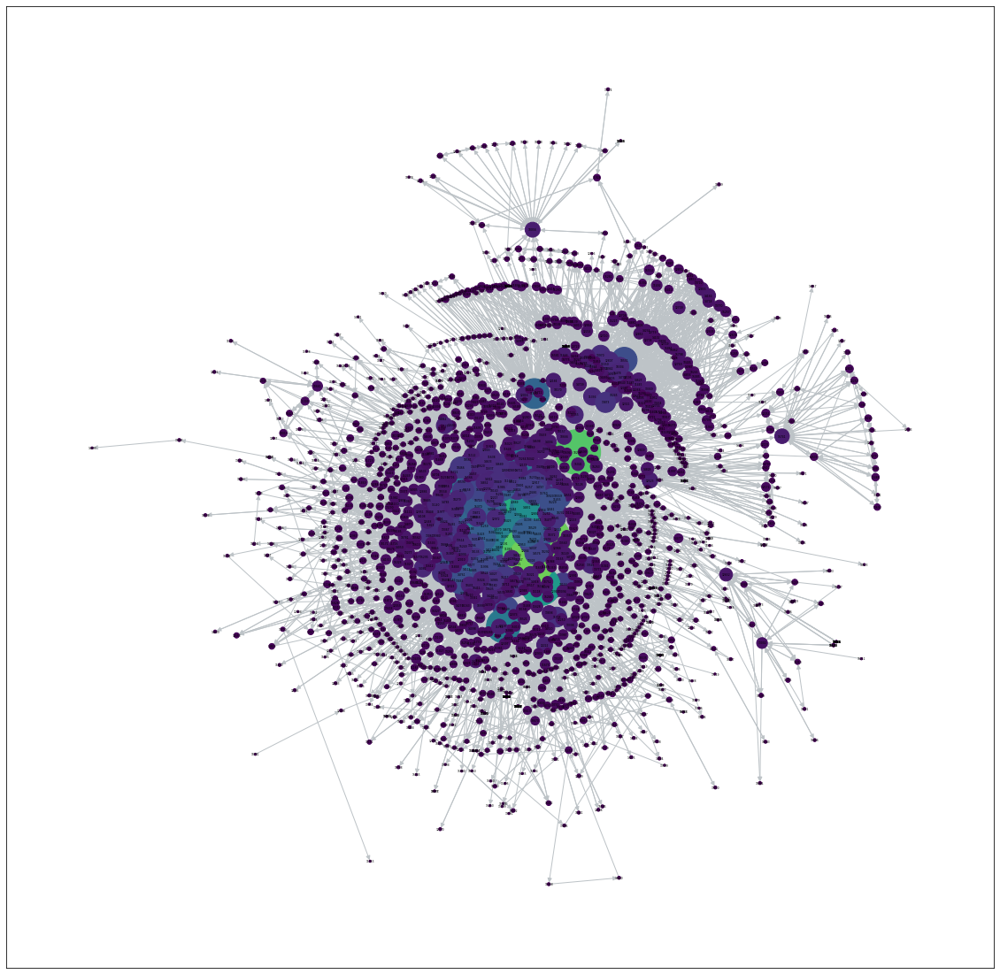

In [121]:
pos = nx.kamada_kawai_layout(Gr3)
degCent = nx.degree_centrality(Gr3)
node_color = [20000.0 * Gr3.degree(v) for v in Gr3]
node_size =  [v * 10000 for v in degCent.values()]
plt.figure(figsize=(20,20))
nx.draw_networkx(Gr3, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size,edge_color="#BDC3C7" ,font_size=3)

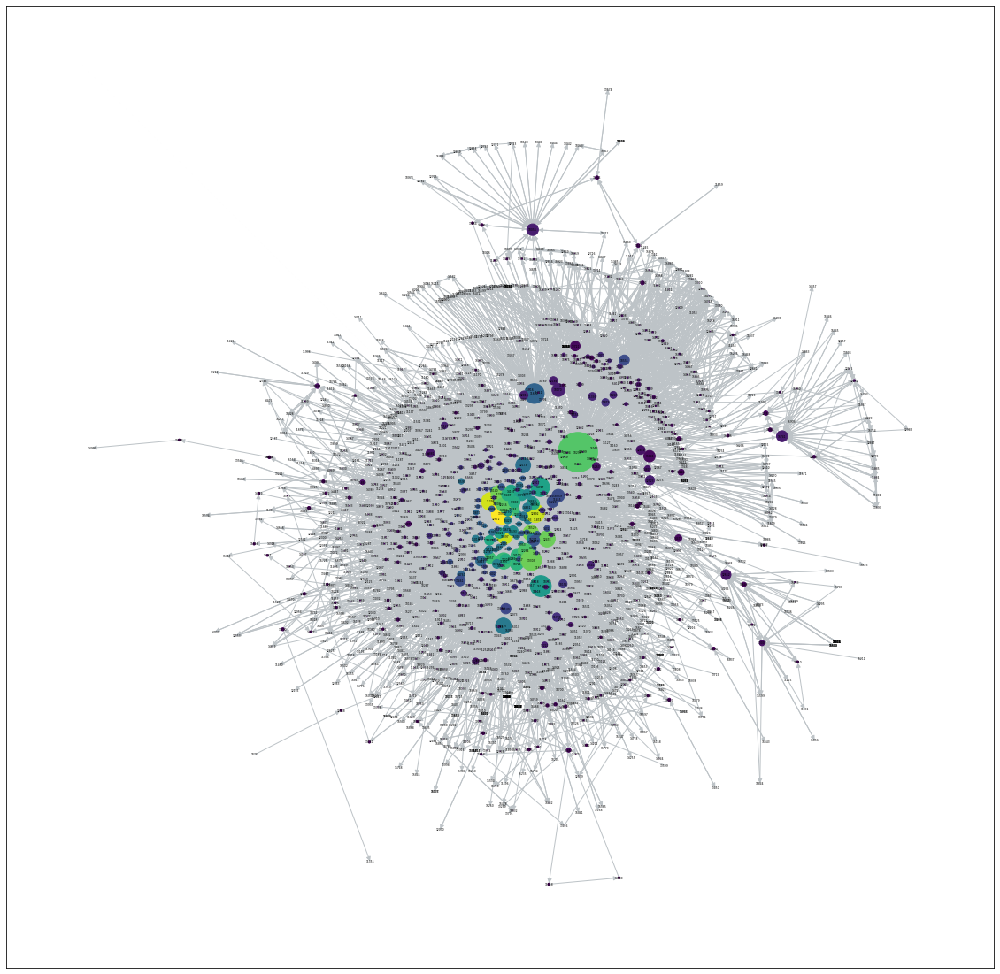

In [122]:
pos = nx.kamada_kawai_layout(Gr3)
degCent = nx.betweenness_centrality(Gr3,normalized=True)
node_color = [20000.0 * Gr3.degree(v) for v in Gr3]
node_size =  [v * 10000 for v in degCent.values()]
plt.figure(figsize=(20,20))
nx.draw_networkx(Gr3, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size,edge_color="#BDC3C7" ,font_size=3)

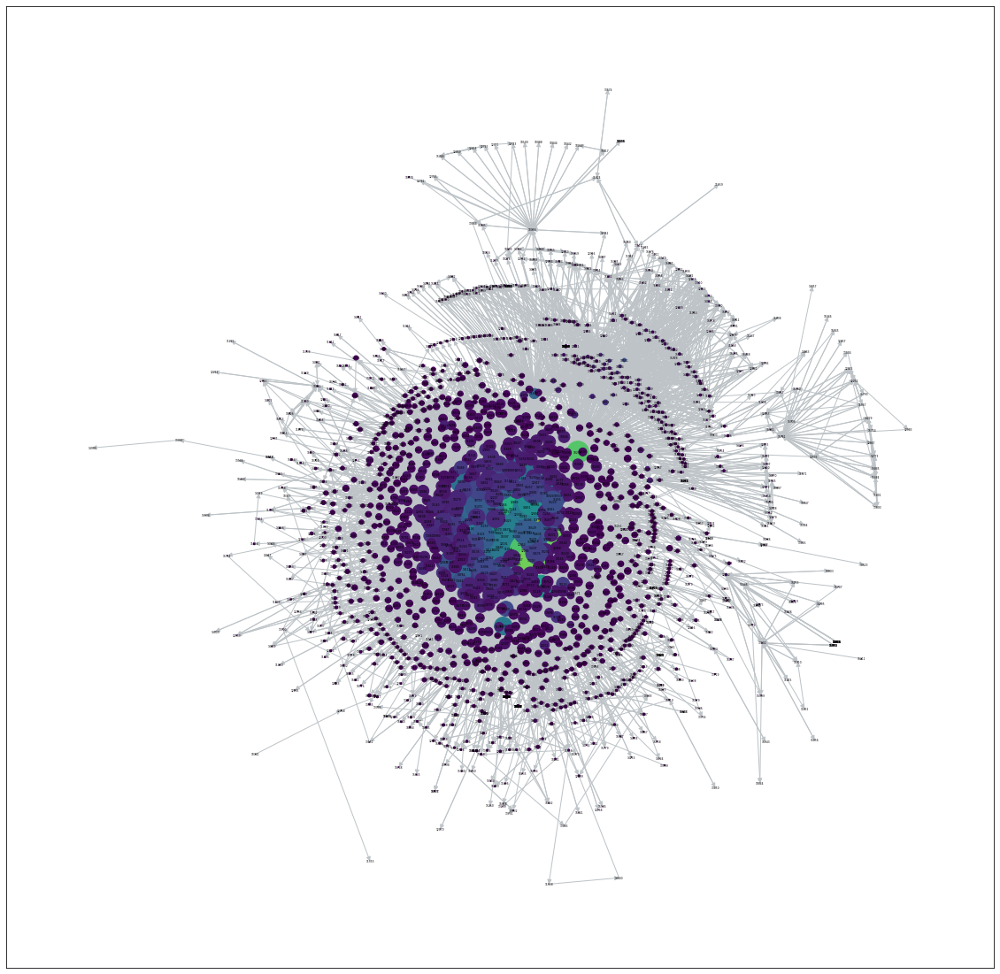

In [123]:
pos = nx.kamada_kawai_layout(Gr3)
degCent = nx.eigenvector_centrality(Gr3)
node_color = [20000.0 * Gr3.degree(v) for v in Gr3]
node_size =  [v * 10000 for v in degCent.values()]
plt.figure(figsize=(20,20))
nx.draw_networkx(Gr3, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size,edge_color="#BDC3C7" ,font_size=3)

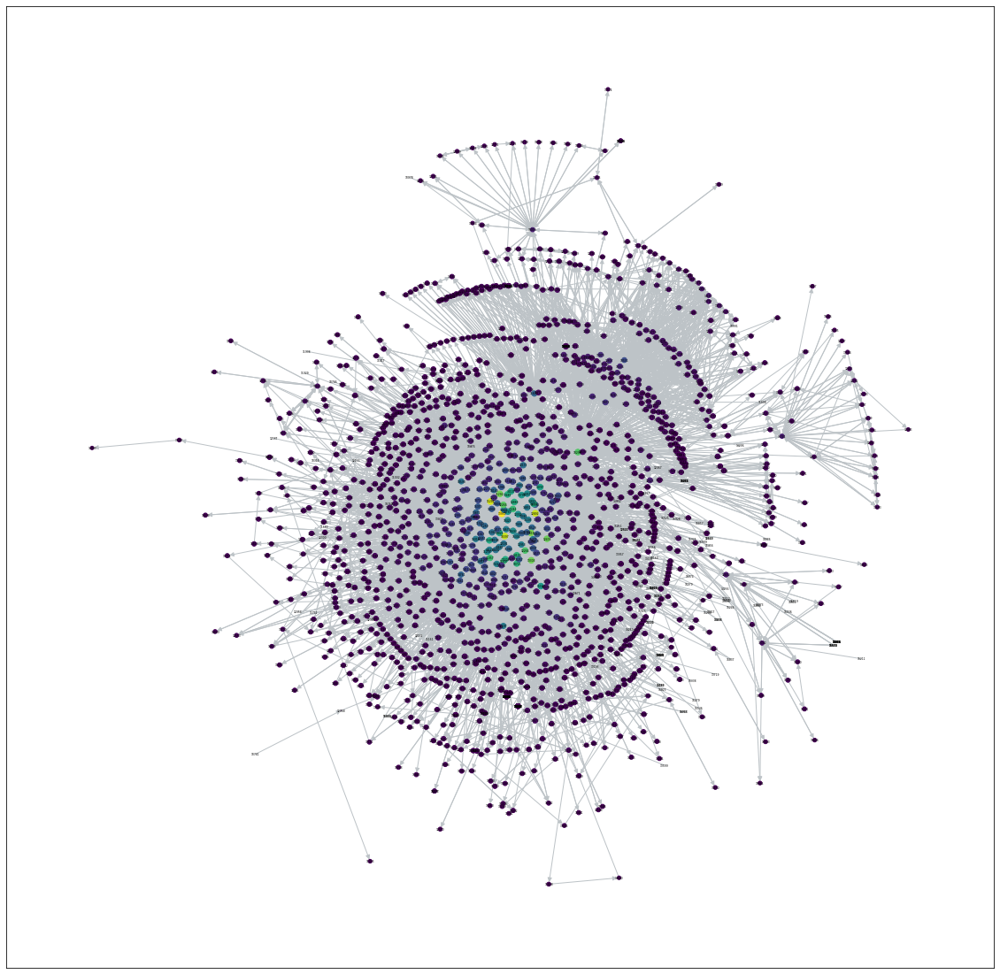

In [18]:
pos = nx.kamada_kawai_layout(Gr3)
degCent = nx.closeness_centrality(Gr3)
node_color = [20000.0 * Gr3.degree(v) for v in Gr3]
node_size =  [v * 100 for v in degCent.values()]
plt.figure(figsize=(20,20))
nx.draw_networkx(Gr3, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size,edge_color="#BDC3C7" ,font_size=3)

In [12]:
degree_centrality = nx.degree_centrality(G1)
closeness_centrality = nx.closeness_centrality(G1)
betweenness_centrality = nx.betweenness_centrality(G1, normalized = True)
eigenvector_centrality = nx.eigenvector_centrality(G1)

maximum_degree_centrality = max(degree_centrality, key = degree_centrality.get)
minimum_degree_centrality = min(degree_centrality, key = degree_centrality.get)
 
maximum_closeness_centrality = max(closeness_centrality, key = closeness_centrality.get)
minimum_closeness_centrality = min(closeness_centrality, key = closeness_centrality.get)
 
maximum_betweenness_centrality = max(betweenness_centrality, key = betweenness_centrality.get)
minimum_betweenness_centrality = min(betweenness_centrality, key = betweenness_centrality.get)

maximum_eigenvector_centrality = max(eigenvector_centrality, key = eigenvector_centrality.get)
minimum_eigenvector_centrality = min(eigenvector_centrality, key = eigenvector_centrality.get)
 
print("%d is the actor with highest Standardized Degree Centrality of %0.5f." % (maximum_degree_centrality, degree_centrality[maximum_degree_centrality]))
print("%d is the actor with highest Standardized Closeness Centrality of %0.5f." % (maximum_closeness_centrality, closeness_centrality[maximum_closeness_centrality]))
print("%d is the actor with highest Standardized Betweenness Centrality of %0.5f." % (maximum_betweenness_centrality, betweenness_centrality[maximum_betweenness_centrality]))
print("%d is the actor with highest Standardized eigenvector Centrality of %0.5f." % (maximum_eigenvector_centrality, eigenvector_centrality[maximum_eigenvector_centrality]))

print("%d is the actor with lowest Standardized Degree Centrality of %0.5f." % (minimum_degree_centrality, degree_centrality[minimum_degree_centrality]))
print("%d is the actor with lowest Standardized Closeness Centrality of %0.5f." % (minimum_closeness_centrality, closeness_centrality[minimum_closeness_centrality]))
print("%d is the actor with lowest Standardized Betweenness Centrality of %0.5f.\n" % (minimum_betweenness_centrality, betweenness_centrality[minimum_betweenness_centrality]))
print("%d is the actor with lowest Standardized eigenvector Centrality of %0.5f." % (minimum_eigenvector_centrality, eigenvector_centrality[minimum_eigenvector_centrality]))

13930 is the actor with highest Standardized Degree Centrality of 0.34841.
13930 is the actor with highest Standardized Closeness Centrality of 0.45658.
10299 is the actor with highest Standardized Betweenness Centrality of 0.18889.
13930 is the actor with highest Standardized eigenvector Centrality of 0.12884.
10063 is the actor with lowest Standardized Degree Centrality of 0.00051.
10078 is the actor with lowest Standardized Closeness Centrality of 0.00000.
12745 is the actor with lowest Standardized Betweenness Centrality of 0.00000.

10078 is the actor with lowest Standardized eigenvector Centrality of 0.00000.


In [13]:
degree_centrality = nx.degree_centrality(Gr1)
closeness_centrality = nx.closeness_centrality(Gr1)
betweenness_centrality = nx.betweenness_centrality(Gr1, normalized = True)
eigenvector_centrality = nx.eigenvector_centrality(Gr1)

maximum_degree_centrality = max(degree_centrality, key = degree_centrality.get)
minimum_degree_centrality = min(degree_centrality, key = degree_centrality.get)
 
maximum_closeness_centrality = max(closeness_centrality, key = closeness_centrality.get)
minimum_closeness_centrality = min(closeness_centrality, key = closeness_centrality.get)
 
maximum_betweenness_centrality = max(betweenness_centrality, key = betweenness_centrality.get)
minimum_betweenness_centrality = min(betweenness_centrality, key = betweenness_centrality.get)

maximum_eigenvector_centrality = max(eigenvector_centrality, key = eigenvector_centrality.get)
minimum_eigenvector_centrality = min(eigenvector_centrality, key = eigenvector_centrality.get)
 
print("%d is the actor with highest Standardized Degree Centrality of %0.5f." % (maximum_degree_centrality, degree_centrality[maximum_degree_centrality]))
print("%d is the actor with highest Standardized Closeness Centrality of %0.5f." % (maximum_closeness_centrality, closeness_centrality[maximum_closeness_centrality]))
print("%d is the actor with highest Standardized Betweenness Centrality of %0.5f." % (maximum_betweenness_centrality, betweenness_centrality[maximum_betweenness_centrality]))
print("%d is the actor with highest Standardized eigenvector Centrality of %0.5f." % (maximum_eigenvector_centrality, eigenvector_centrality[maximum_eigenvector_centrality]))

print("%d is the actor with lowest Standardized Degree Centrality of %0.5f." % (minimum_degree_centrality, degree_centrality[minimum_degree_centrality]))
print("%d is the actor with lowest Standardized Closeness Centrality of %0.5f." % (minimum_closeness_centrality, closeness_centrality[minimum_closeness_centrality]))
print("%d is the actor with lowest Standardized Betweenness Centrality of %0.5f.\n" % (minimum_betweenness_centrality, betweenness_centrality[minimum_betweenness_centrality]))
print("%d is the actor with lowest Standardized eigenvector Centrality of %0.5f." % (minimum_eigenvector_centrality, eigenvector_centrality[minimum_eigenvector_centrality]))

13930 is the actor with highest Standardized Degree Centrality of 0.39301.
12892 is the actor with highest Standardized Closeness Centrality of 0.45778.
10299 is the actor with highest Standardized Betweenness Centrality of 0.22052.
10397 is the actor with highest Standardized eigenvector Centrality of 0.14461.
10042 is the actor with lowest Standardized Degree Centrality of 0.00071.
10298 is the actor with lowest Standardized Closeness Centrality of 0.00000.
10005 is the actor with lowest Standardized Betweenness Centrality of 0.00000.

10298 is the actor with lowest Standardized eigenvector Centrality of 0.00000.


In [14]:
degree_centrality = nx.degree_centrality(Gr2)
closeness_centrality = nx.closeness_centrality(Gr2)
betweenness_centrality = nx.betweenness_centrality(Gr2, normalized = True)
eigenvector_centrality = nx.eigenvector_centrality(Gr2)

maximum_degree_centrality = max(degree_centrality, key = degree_centrality.get)
minimum_degree_centrality = min(degree_centrality, key = degree_centrality.get)
 
maximum_closeness_centrality = max(closeness_centrality, key = closeness_centrality.get)
minimum_closeness_centrality = min(closeness_centrality, key = closeness_centrality.get)
 
maximum_betweenness_centrality = max(betweenness_centrality, key = betweenness_centrality.get)
minimum_betweenness_centrality = min(betweenness_centrality, key = betweenness_centrality.get)

maximum_eigenvector_centrality = max(eigenvector_centrality, key = eigenvector_centrality.get)
minimum_eigenvector_centrality = min(eigenvector_centrality, key = eigenvector_centrality.get)
 
print("%d is the actor with highest Standardized Degree Centrality of %0.5f." % (maximum_degree_centrality, degree_centrality[maximum_degree_centrality]))
print("%d is the actor with highest Standardized Closeness Centrality of %0.5f." % (maximum_closeness_centrality, closeness_centrality[maximum_closeness_centrality]))
print("%d is the actor with highest Standardized Betweenness Centrality of %0.5f." % (maximum_betweenness_centrality, betweenness_centrality[maximum_betweenness_centrality]))
print("%d is the actor with highest Standardized eigenvector Centrality of %0.5f." % (maximum_eigenvector_centrality, eigenvector_centrality[maximum_eigenvector_centrality]))

print("%d is the actor with lowest Standardized Degree Centrality of %0.5f." % (minimum_degree_centrality, degree_centrality[minimum_degree_centrality]))
print("%d is the actor with lowest Standardized Closeness Centrality of %0.5f." % (minimum_closeness_centrality, closeness_centrality[minimum_closeness_centrality]))
print("%d is the actor with lowest Standardized Betweenness Centrality of %0.5f.\n" % (minimum_betweenness_centrality, betweenness_centrality[minimum_betweenness_centrality]))
print("%d is the actor with lowest Standardized eigenvector Centrality of %0.5f." % (minimum_eigenvector_centrality, eigenvector_centrality[minimum_eigenvector_centrality]))

13930 is the actor with highest Standardized Degree Centrality of 0.38496.
13930 is the actor with highest Standardized Closeness Centrality of 0.45475.
10299 is the actor with highest Standardized Betweenness Centrality of 0.22234.
13930 is the actor with highest Standardized eigenvector Centrality of 0.14338.
10040 is the actor with lowest Standardized Degree Centrality of 0.00065.
10005 is the actor with lowest Standardized Closeness Centrality of 0.00000.
10005 is the actor with lowest Standardized Betweenness Centrality of 0.00000.

10005 is the actor with lowest Standardized eigenvector Centrality of 0.00000.


In [15]:
degree_centrality = nx.degree_centrality(Gr3)
closeness_centrality = nx.closeness_centrality(Gr3)
betweenness_centrality = nx.betweenness_centrality(Gr3, normalized = True)
eigenvector_centrality = nx.eigenvector_centrality(Gr3)

maximum_degree_centrality = max(degree_centrality, key = degree_centrality.get)
minimum_degree_centrality = min(degree_centrality, key = degree_centrality.get)
 
maximum_closeness_centrality = max(closeness_centrality, key = closeness_centrality.get)
minimum_closeness_centrality = min(closeness_centrality, key = closeness_centrality.get)
 
maximum_betweenness_centrality = max(betweenness_centrality, key = betweenness_centrality.get)
minimum_betweenness_centrality = min(betweenness_centrality, key = betweenness_centrality.get)

maximum_eigenvector_centrality = max(eigenvector_centrality, key = eigenvector_centrality.get)
minimum_eigenvector_centrality = min(eigenvector_centrality, key = eigenvector_centrality.get)
 
print("%d is the actor with highest Standardized Degree Centrality of %0.5f." % (maximum_degree_centrality, degree_centrality[maximum_degree_centrality]))
print("%d is the actor with highest Standardized Closeness Centrality of %0.5f." % (maximum_closeness_centrality, closeness_centrality[maximum_closeness_centrality]))
print("%d is the actor with highest Standardized Betweenness Centrality of %0.5f." % (maximum_betweenness_centrality, betweenness_centrality[maximum_betweenness_centrality]))
print("%d is the actor with highest Standardized eigenvector Centrality of %0.5f." % (maximum_eigenvector_centrality, eigenvector_centrality[maximum_eigenvector_centrality]))

print("%d is the actor with lowest Standardized Degree Centrality of %0.5f." % (minimum_degree_centrality, degree_centrality[minimum_degree_centrality]))
print("%d is the actor with lowest Standardized Closeness Centrality of %0.5f." % (minimum_closeness_centrality, closeness_centrality[minimum_closeness_centrality]))
print("%d is the actor with lowest Standardized Betweenness Centrality of %0.5f.\n" % (minimum_betweenness_centrality, betweenness_centrality[minimum_betweenness_centrality]))
print("%d is the actor with lowest Standardized eigenvector Centrality of %0.5f." % (minimum_eigenvector_centrality, eigenvector_centrality[minimum_eigenvector_centrality]))

13930 is the actor with highest Standardized Degree Centrality of 0.35868.
13930 is the actor with highest Standardized Closeness Centrality of 0.44897.
10299 is the actor with highest Standardized Betweenness Centrality of 0.19925.
13930 is the actor with highest Standardized eigenvector Centrality of 0.14190.
10556 is the actor with lowest Standardized Degree Centrality of 0.00060.
10078 is the actor with lowest Standardized Closeness Centrality of 0.00000.
10005 is the actor with lowest Standardized Betweenness Centrality of 0.00000.

10078 is the actor with lowest Standardized eigenvector Centrality of 0.00000.


In [ ]:
infile2 = "flights-test1.txt"
graphtype2 = nx.Graph()

G2 = nx.read_edgelist(infile2, create_using = graphtype2, nodetype = int)

greedy_community = list(community.greedy_modularity_communities(G2))

In [26]:
print(len(greedy_community))
print(len(greedy_community[0]))

16
686


In [27]:
c1 = greedy_community[0]
c1

frozenset({10010,
           10127,
           10130,
           10147,
           10148,
           10150,
           10154,
           10158,
           10160,
           10162,
           10198,
           10201,
           10205,
           10208,
           10209,
           10224,
           10287,
           10292,
           10302,
           10309,
           10310,
           10312,
           10329,
           10357,
           10361,
           10371,
           10374,
           10386,
           10394,
           10397,
           10409,
           10414,
           10415,
           10427,
           10444,
           10448,
           10470,
           10472,
           10478,
           10482,
           10486,
           10503,
           10504,
           10517,
           10519,
           10521,
           10535,
           10540,
           10542,
           10545,
           10568,
           10569,
           10575,
           10577,
           10581,
          

In [28]:
df = pd.read_csv("airline_edges.csv")

df_c1 = (df[(df['ORIGIN_AIRPORT_ID'].isin(c1)) & (df['DEST_AIRPORT_ID'].isin(c1))])
df_c1.reset_index(drop=True)

,UNIQUE_CARRIER_NAME,ORIGIN_AIRPORT_ID,Source,DEST_AIRPORT_ID,Target,MONTH
0,Miami Air International,11618,EWR,10540,BED,3
1,Miami Air International,11618,EWR,10581,BGR,3
2,Miami Air International,11618,EWR,13303,MIA,3
3,Miami Air International,12216,HST,13303,MIA,3
4,Miami Air International,13303,MIA,10397,ATL,3
...,...,...,...,...,...,...
28037,Delta Air Lines Inc.,10397,ATL,11697,FLL,5
28038,Delta Air Lines Inc.,10397,ATL,11697,FLL,3
28039,Delta Air Lines Inc.,11697,FLL,10397,ATL,5
28040,Delta Air Lines Inc.,11697,FLL,10397,ATL,7


In [ ]:
GC1_type = nx.DiGraph()
GC1 = nx.from_pandas_edgelist(df_c1, 'ORIGIN_AIRPORT_ID', 'DEST_AIRPORT_ID', create_using = GC1_type)

15167 is the actor with highest Standardized Degree Centrality of 0.55766.
15167 is the actor with highest Standardized Closeness Centrality of 0.49365.
15167 is the actor with highest Standardized Betweenness Centrality of 0.18178.
11345 is the actor with highest Standardized Degree Centrality of 0.00146.
13736 is the actor with highest Standardized Closeness Centrality of 0.00000.
13736 is the actor with highest Standardized Betweenness Centrality of 0.00000.

11298 is the actor with highest Standardized Degree Centrality of 0.69955.
11298 is the actor with highest Standardized Closeness Centrality of 0.54834.
12892 is the actor with highest Standardized Betweenness Centrality of 0.07532.
16849 is the actor with highest Standardized Degree Centrality of 0.00149.
10186 is the actor with highest Standardized Closeness Centrality of 0.00000.
10739 is the actor with highest Standardized Betweenness Centrality of 0.00000.

10299 is the actor with highest Standardized Degree Centrality of 

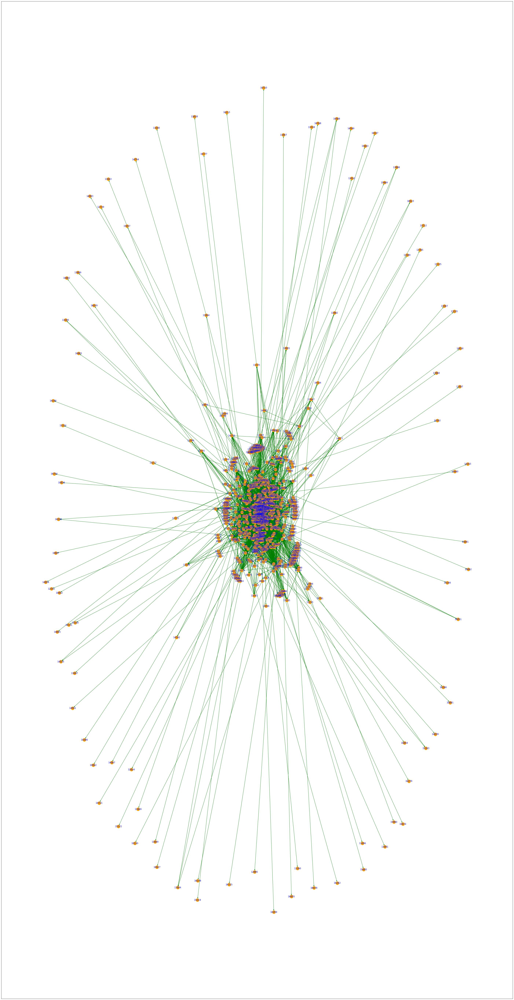

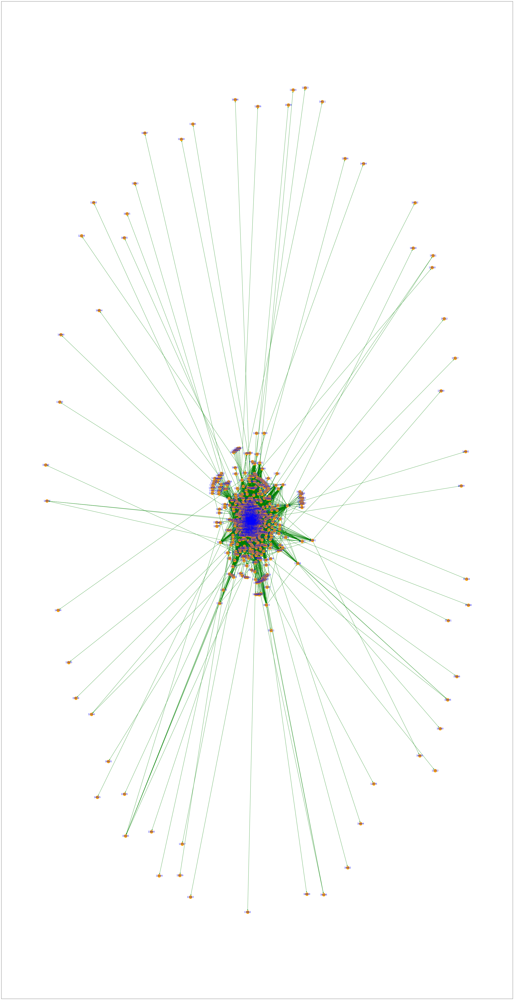

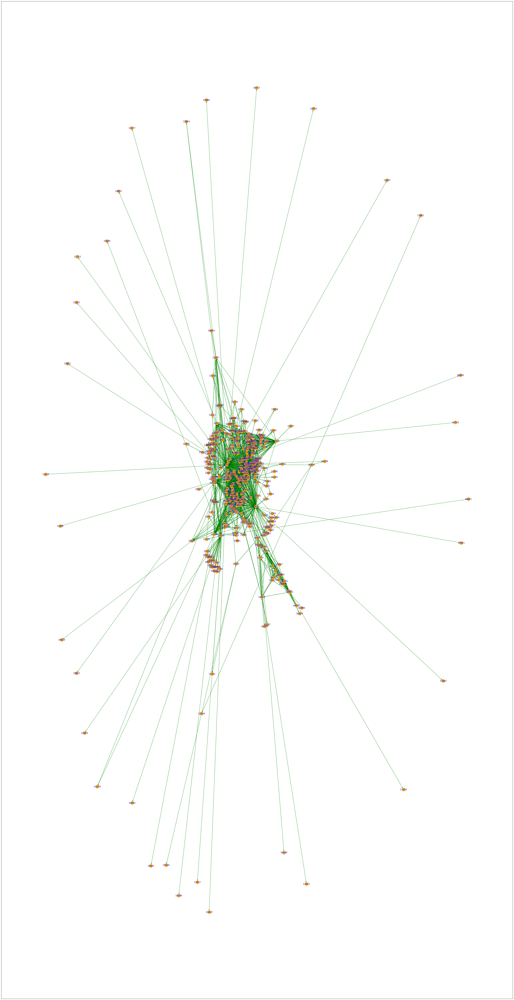

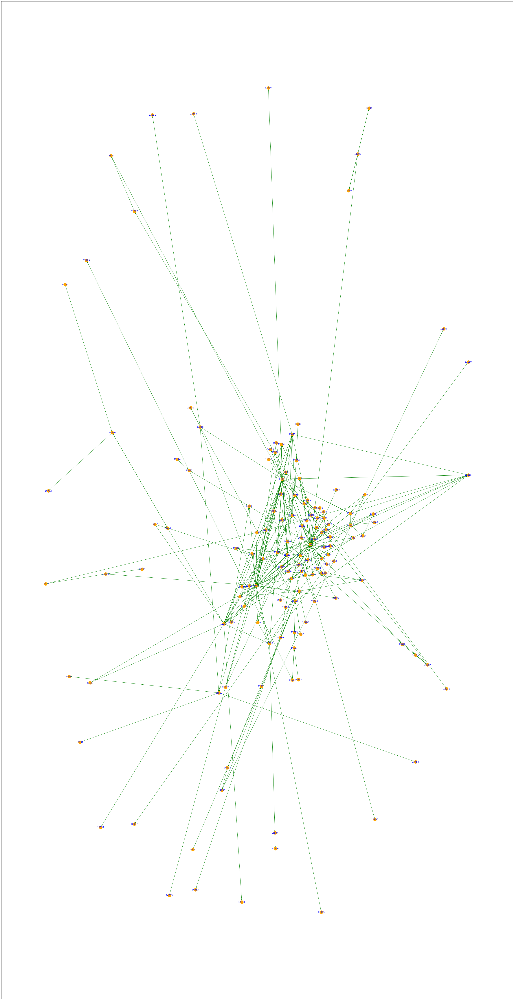

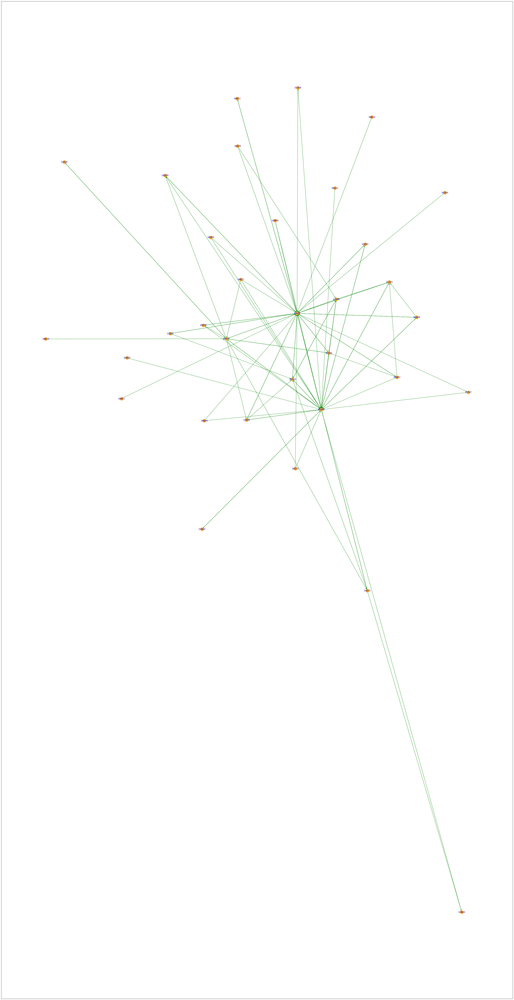

...

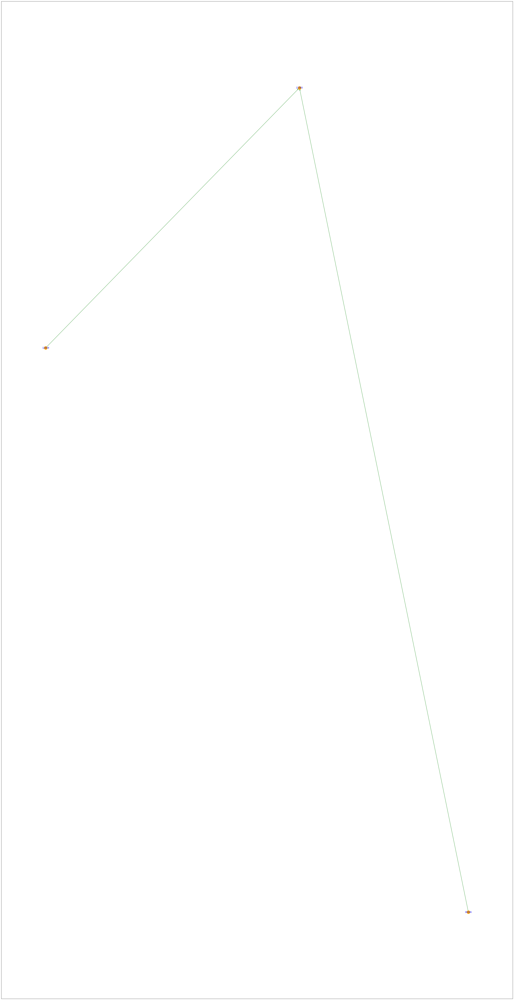

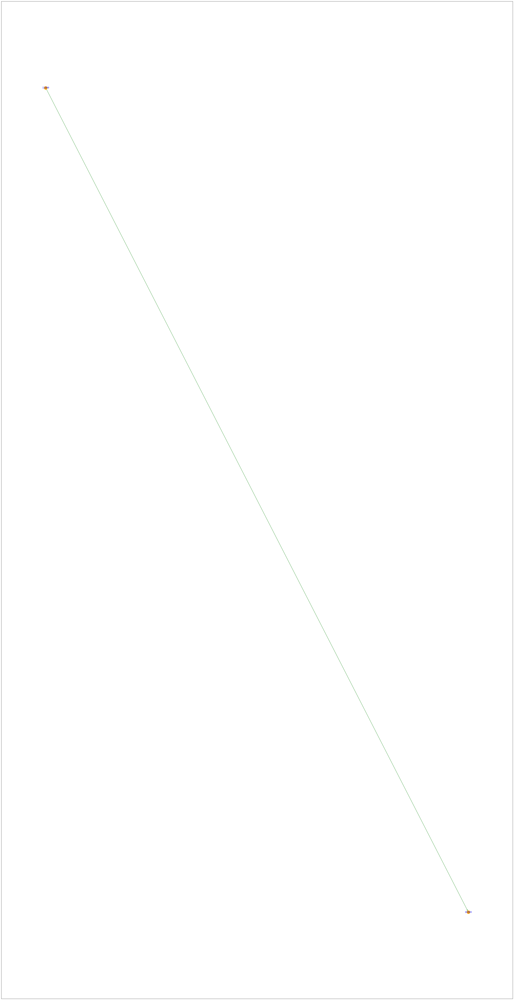

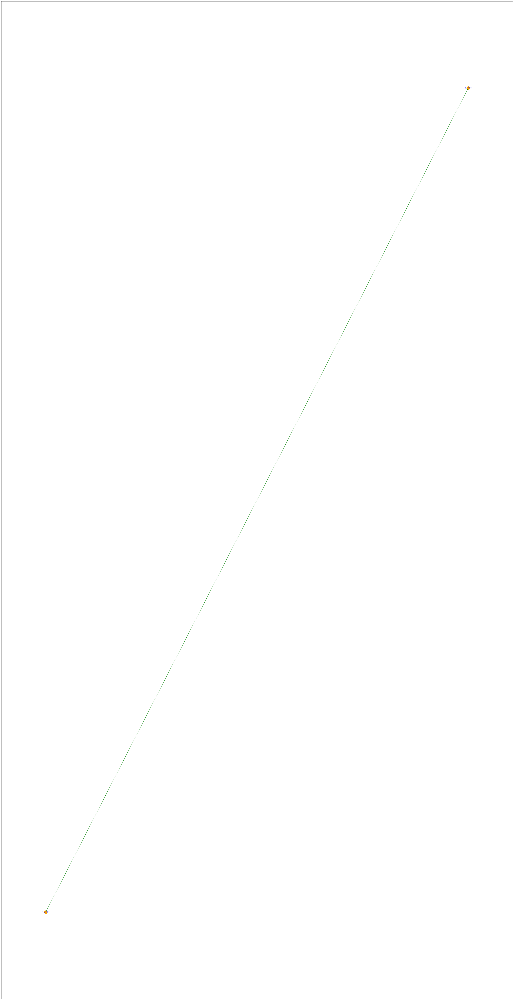

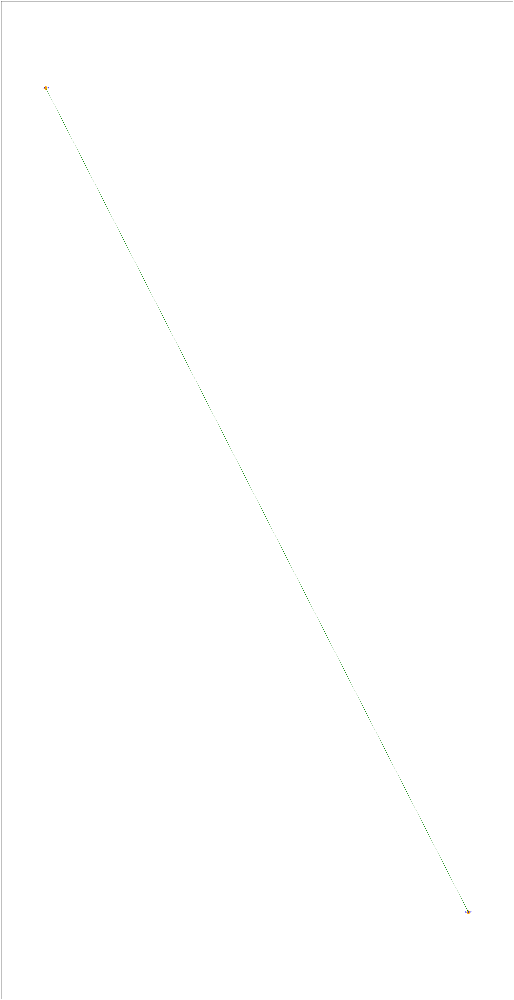

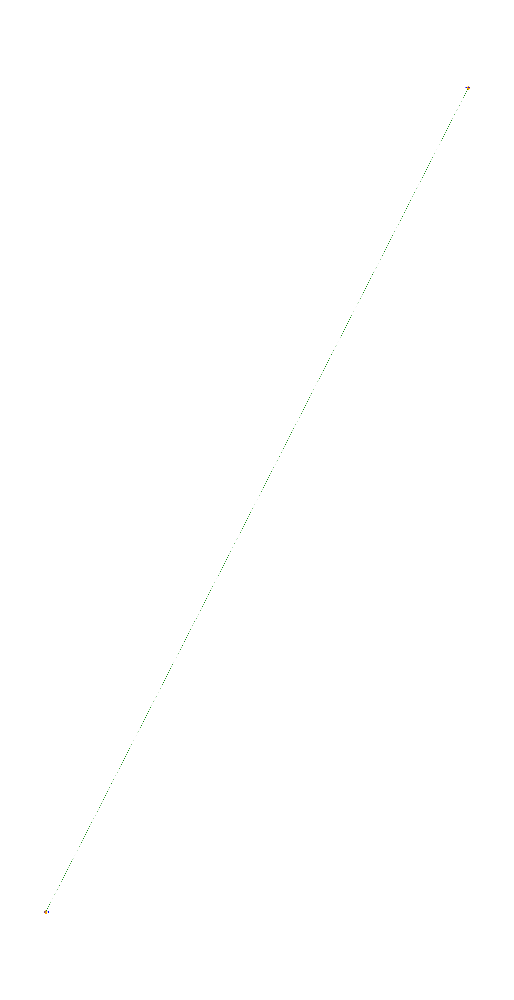

In [34]:
for c1 in greedy_community:
  df_c1 = (df[(df['ORIGIN_AIRPORT_ID'].isin(c1)) & (df['DEST_AIRPORT_ID'].isin(c1))])
  df_c1.reset_index(drop=True)
  GC1 = nx.from_pandas_edgelist(df_c1, 'ORIGIN_AIRPORT_ID', 'DEST_AIRPORT_ID', create_using = GC1_type)

  degree_centrality = nx.degree_centrality(GC1_type)
  closeness_centrality = nx.closeness_centrality(GC1_type)
  betweenness_centrality = nx.betweenness_centrality(GC1_type, normalized = True)

  maximum_degree_centrality = max(degree_centrality, key = degree_centrality.get)
  minimum_degree_centrality = min(degree_centrality, key = degree_centrality.get)

  maximum_closeness_centrality = max(closeness_centrality, key = closeness_centrality.get)
  minimum_closeness_centrality = min(closeness_centrality, key = closeness_centrality.get)

  maximum_betweenness_centrality = max(betweenness_centrality, key = betweenness_centrality.get)
  minimum_betweenness_centrality = min(betweenness_centrality, key = betweenness_centrality.get)

  print("%d is the actor with highest Standardized Degree Centrality of %0.5f." % (maximum_degree_centrality, degree_centrality[maximum_degree_centrality]))
  print("%d is the actor with highest Standardized Closeness Centrality of %0.5f." % (maximum_closeness_centrality, closeness_centrality[maximum_closeness_centrality]))
  print("%d is the actor with highest Standardized Betweenness Centrality of %0.5f." % (maximum_betweenness_centrality, betweenness_centrality[maximum_closeness_centrality]))

  print("%d is the actor with highest Standardized Degree Centrality of %0.5f." % (minimum_degree_centrality, degree_centrality[minimum_degree_centrality]))
  print("%d is the actor with highest Standardized Closeness Centrality of %0.5f." % (minimum_closeness_centrality, closeness_centrality[minimum_closeness_centrality]))
  print("%d is the actor with highest Standardized Betweenness Centrality of %0.5f.\n" % (minimum_betweenness_centrality, betweenness_centrality[minimum_closeness_centrality]))
  
  plt.figure(figsize = (50,100))
  nx.draw_networkx(GC1, node_color = 'orange', font_color = 'blue', edge_color = 'green')

In [7]:
airports=pd.read_excel("codes.xlsx")
airports

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,1,Goroka Airport,Goroka,Papua New Guinea,GKA,AYGA,-6.081690,145.391998,5282,10,U,Pacific/Port_Moresby,airport,OurAirports
1,2,Madang Airport,Madang,Papua New Guinea,MAG,AYMD,-5.207080,145.789001,20,10,U,Pacific/Port_Moresby,airport,OurAirports
2,3,Mount Hagen Kagamuga Airport,Mount Hagen,Papua New Guinea,HGU,AYMH,-5.826790,144.296005,5388,10,U,Pacific/Port_Moresby,airport,OurAirports
3,4,Nadzab Airport,Nadzab,Papua New Guinea,LAE,AYNZ,-6.569803,146.725977,239,10,U,Pacific/Port_Moresby,airport,OurAirports
4,5,Port Moresby Jacksons International Airport,Port Moresby,Papua New Guinea,POM,AYPY,-9.443380,147.220001,146,10,U,Pacific/Port_Moresby,airport,OurAirports
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7693,14106,Rogachyovo Air Base,Belaya,Russia,\N,ULDA,71.616699,52.478298,272,\N,\N,\N,airport,OurAirports
7694,14107,Ulan-Ude East Airport,Ulan Ude,Russia,\N,XIUW,51.849998,107.737999,1670,\N,\N,\N,airport,OurAirports
7695,14108,Krechevitsy Air Base,Novgorod,Russia,\N,ULLK,58.625000,31.385000,85,\N,\N,\N,airport,OurAirports
7696,14109,Desierto de Atacama Airport,Copiapo,Chile,CPO,SCAT,-27.261200,-70.779198,670,\N,\N,\N,airport,OurAirports


In [8]:
import pandas as pd
data=pd.read_csv("airline_edges.csv")
data.head()
a=set(list(data["Source"]))
b=set(list(data["Target"]))
c=a.union(b)
len(c)
airports_data=pd.DataFrame(c,columns=["IATA"])
airports_data

,IATA
0,OAJ
1,EWK
2,SMV
3,IND
4,CDC
...,...
1941,NGB
1942,BBX
1943,TYS
1944,WKR


In [40]:
airport_col = ['ID', 'Name', 'City', 'Country','IATA', 'ICAO', 'Lat', 'Long', 'Alt', 
               'Timezone', 'DST', 'Tz database time zone', 'type', 'source']
airport_df = pd.read_csv("https://raw.githubusercontent.com/jpatokal/openflights/master/data/airports.dat",
                        names = airport_col, index_col = 0)
new=airports_data.merge(airport_df,how="left", on="IATA")
new.dropna(how="any",inplace=True)
new[new["Lat"].isnull()]
new.head()

,IATA,Name,City,Country,ICAO,Lat,Long,Alt,Timezone,DST,Tz database time zone,type,source
0,OAJ,Albert J Ellis Airport,Jacksonville NC,United States,KOAJ,34.829201,-77.612099,94.0,-5,A,America/New_York,airport,OurAirports
1,EWK,Newton City-County Airport,Newton,United States,KEWK,38.058201,-97.274498,1533.0,-6,A,America/Chicago,airport,OurAirports
2,SMV,Samedan Airport,Samedan,Switzerland,LSZS,46.534100,9.884110,5600.0,1,E,Europe/Zurich,airport,OurAirports
3,IND,Indianapolis International Airport,Indianapolis,United States,KIND,39.717300,-86.294403,797.0,-5,A,America/New_York,airport,OurAirports
4,CDC,Cedar City Regional Airport,Cedar City,United States,KCDC,37.701000,-113.098999,5622.0,-7,A,America/Denver,airport,OurAirports


In [53]:
airports=airports[[1,4,6,7]]
airports.dropna(how="any")
airports[airports[4]=='LCR']

,1,4,6,7


In [10]:
routes=pd.read_csv("https://raw.githubusercontent.com/jpatokal/openflights/master/data/routes.dat",header=None)
routes

,0,1,2,3,4,5,6,7,8
0,2B,410,AER,2965,KZN,2990,NaN,0,CR2
1,2B,410,ASF,2966,KZN,2990,NaN,0,CR2
2,2B,410,ASF,2966,MRV,2962,NaN,0,CR2
3,2B,410,CEK,2968,KZN,2990,NaN,0,CR2
4,2B,410,CEK,2968,OVB,4078,NaN,0,CR2
...,...,...,...,...,...,...,...,...,...
67658,ZL,4178,WYA,6334,ADL,3341,NaN,0,SF3
67659,ZM,19016,DME,4029,FRU,2912,NaN,0,734
67660,ZM,19016,FRU,2912,DME,4029,NaN,0,734
67661,ZM,19016,FRU,2912,OSS,2913,NaN,0,734


In [51]:
routes=routes[[2,4]]
routes["conn"]=1
routes[(routes[2]=="ABE") & (routes[4]=="ATL")]
routes_us = routes.groupby([2,4]).size().reset_index(name='counts')
routes_us.dropna(how="any")
routes_us[routes_us[2]=="LCR"]

,2,4,counts
19116,LCR,ACR,1
19117,LCR,LET,1


In [92]:
routes_data=pd.read_csv("airline_edges.csv")
routes_data.head()

,UNIQUE_CARRIER_NAME,ORIGIN_AIRPORT_ID,Source,DEST_AIRPORT_ID,Target,MONTH
0,Empire Airlines Inc.,10140,ABQ,11413,DRO,3
1,Empire Airlines Inc.,10140,ABQ,11711,FMN,3
2,Empire Airlines Inc.,10194,AFW,12278,ICT,3
3,Empire Airlines Inc.,10194,AFW,12896,LBB,3
4,Empire Airlines Inc.,10194,AFW,13158,MAF,3


In [12]:
# airport_col = ['ID', 'Name', 'City', 'Country','IATA', 'ICAO', 'Lat', 'Long', 'Alt', 
#                'Timezone', 'DST', 'Tz database time zone', 'type', 'source']
# airport_df = pd.read_csv("https://raw.githubusercontent.com/jpatokal/openflights/master/data/airports.dat",
#                         names = airport_col, index_col = 0)
# # download flight routes data
# route_cols = ['Airline', 'Airline ID', 'Source Airport', 'Source Airport ID',
#               'Dest Airport', 'Dest Airport ID', 'Codeshare', 'Stops', 'equipment']
# routes_df = pd.read_csv("https://raw.githubusercontent.com/jpatokal/openflights/master/data/routes.dat",
#                         names = route_cols)
#clean up data, change 'object' type to numeric and drops NaNs
routes_data['Source'] = pd.to_numeric(routes_data['Source'].astype(str), 'coerce')
routes_data['Target'] = pd.to_numeric(routes_data['Target'].astype(str), 'coerce')
routes_data = routes_data.dropna(subset=["Source", "Target"])

In [45]:
airport_data.head()

,Name,Lat,Long,IATA,ICAO,City
0,Albert J Ellis Airport,34.829201,-77.612099,OAJ,KOAJ,Jacksonville NC
1,Newton City-County Airport,38.058201,-97.274498,EWK,KEWK,Newton
3,Indianapolis International Airport,39.717300,-86.294403,IND,KIND,Indianapolis
4,Cedar City Regional Airport,37.701000,-113.098999,CDC,KCDC,Cedar City
6,Chenega Bay Airport,60.077301,-147.992004,NCN,PFCB,Chenega


In [93]:
routes_data=routes_data[['Source','Target']]
routes_data['num']=1
routes_data

,Source,Target,num
0,ABQ,DRO,1
1,ABQ,FMN,1
2,AFW,ICT,1
3,AFW,LBB,1
4,AFW,MAF,1
...,...,...,...
263841,ANC,SEA,1
263842,SEA,ANC,1
263843,ANC,SEA,1
263844,MCO,ATL,1


In [94]:
# # routes_data['Source'].append(routes_data.loc[routes_data['Source'] != routes_data['Target'], 'Target']).value_counts()
# # routes_data.loc[routes_data['Source'] != routes_data['Target'], 'Target']

# # routes_data["Source"].value_counts()
# counts=list(routes_data["Source"])
# counts.extend(list(routes_data["Target"]))
# counts=pd.DataFrame(counts,columns=["IATA"])
# counts=counts["IATA"].value_counts()
# counts

In [96]:
x=list(airport_data["IATA"])
routes_data=routes_data[(routes_data["Source"].isin(x)) & (routes_data["Target"].isin(x))]
routes_data

,Source,Target,num
0,ABQ,DRO,1
1,ABQ,FMN,1
2,AFW,ICT,1
3,AFW,LBB,1
4,AFW,MAF,1
...,...,...,...
263841,ANC,SEA,1
263842,SEA,ANC,1
263843,ANC,SEA,1
263844,MCO,ATL,1


In [97]:
airport_data = new[(new.Country == "United States")][['Name','Lat', 'Long', 'IATA', 'ICAO',"City"]]
x=list(airport_data["IATA"])
routes_data=routes_data[(routes_data["Source"].isin(x)) & (routes_data["Target"].isin(x))]
routes_data =  pd.DataFrame(routes_data.groupby(['Source', 'Target']).size().reset_index(name='counts'))
counts=list(routes_data["Source"])
counts.extend(list(routes_data["Target"]))
counts=pd.DataFrame(counts,columns=["IATA"])
counts=counts["IATA"].value_counts()

counts = pd.DataFrame({'IATA': counts.index, 'total_flight': counts})
pos_data = counts.merge(airport_data, on = 'IATA')
pos_data[pos_data["total_flight"].isnull()]
pos_data

,IATA,total_flight,Name,Lat,Long,ICAO,City
0,ORD,455,Chicago O'Hare International Airport,41.978600,-87.904800,KORD,Chicago
1,DEN,437,Denver International Airport,39.861698,-104.672997,KDEN,Denver
2,DFW,430,Dallas Fort Worth International Airport,32.896801,-97.038002,KDFW,Dallas-Fort Worth
3,ATL,396,Hartsfield Jackson Atlanta International Airport,33.636700,-84.428101,KATL,Atlanta
4,MSP,378,Minneapolis-St Paul International/Wold-Chamber...,44.882000,-93.221802,KMSP,Minneapolis
...,...,...,...,...,...,...,...
875,HLG,1,Wheeling Ohio County Airport,40.174999,-80.646301,KHLG,Wheeling
876,RAC,1,John H Batten Airport,42.760601,-87.815201,KRAC,Racine
877,LVK,1,Livermore Municipal Airport,37.693401,-121.820000,KLVK,Livermore
878,MPV,1,Edward F Knapp State Airport,44.203499,-72.562302,KMPV,Montpelier


In [98]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import os
os.environ["PROJ_LIB"] = "C:\\Users\\likhi\\Anaconda3\\Library\\share"; #fixr
from mpl_toolkits.basemap import Basemap

import matplotlib.pyplot as plt
# plt.figure(figsize = (20,20))
# # setup Lambert Conformal basemap.
# # set resolution=None to skip processing of boundary datasets.
# m = Basemap(width=12000000,height=9000000,projection='lcc',
#             resolution=None,lat_1=45.,lat_2=55,lat_0=50,lon_0=-107.)
# m.bluemarble()
# plt.show()

In [99]:
# graph = nx.from_pandas_edgelist(routes_us, source = 2, target = 4, edge_attr = 'counts',create_using = nx.DiGraph())
graph = nx.from_pandas_edgelist(routes_data, source = 'Source', target = 'Target',edge_attr = 'counts',create_using = nx.DiGraph())

C:\Users\likhi\Anaconda3\lib\site-packages\networkx\drawing\nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):
C:\Users\likhi\Anaconda3\lib\site-packages\networkx\drawing\nx_pylab.py:676: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if cb.iterable(node_size):  # many node sizes


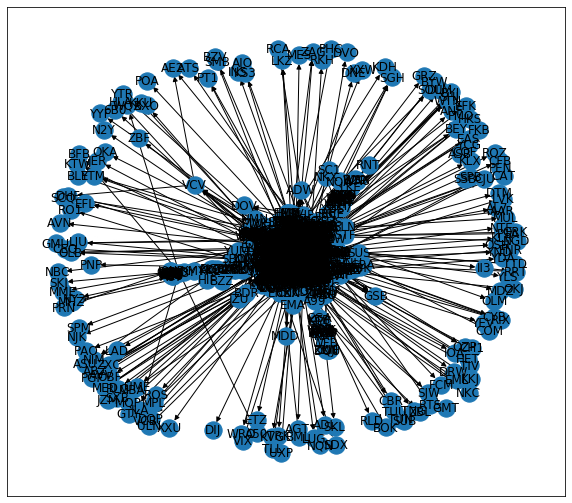

In [89]:
plt.figure(figsize = (10,9))
nx.draw_networkx(graph)
# plt.savefig("./images/map_0.png", format = "png", dpi = 300)
plt.show()

NameError: name 'airports' is not defined

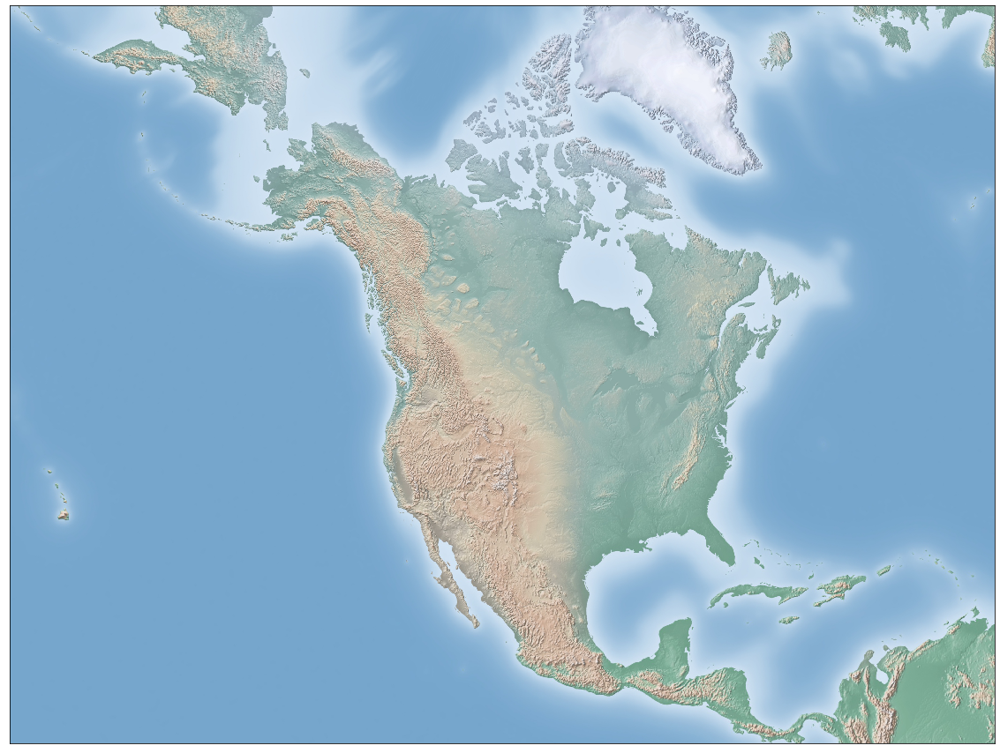

In [90]:
plt.figure(figsize = (20,20))
# setup Lambert Conformal basemap.
# set resolution=None to skip processing of boundary datasets.
m = Basemap(width=12000000,height=9000000,projection='lcc',
            resolution=None,lat_1=45.,lat_2=55,lat_0=50,lon_0=-107.)
m.shadedrelief()

mx, my = m(airports[7].values, airports[6].values)
pos = {}
for count, elem in enumerate (airports[4]):
     pos[elem] = (mx[count], my[count])

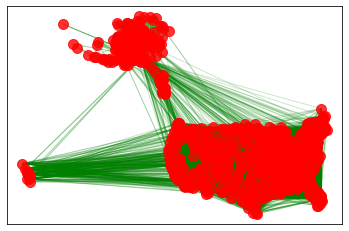

In [100]:
nx.draw_networkx_nodes(G = graph, pos = pos, node_list = graph.nodes(),node_color = 'r', alpha = 0.8, node_size = 100)
nx.draw_networkx_edges(G = graph, pos = pos, edge_color='g', alpha=0.2, arrows = False)

C:\Users\likhi\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  """


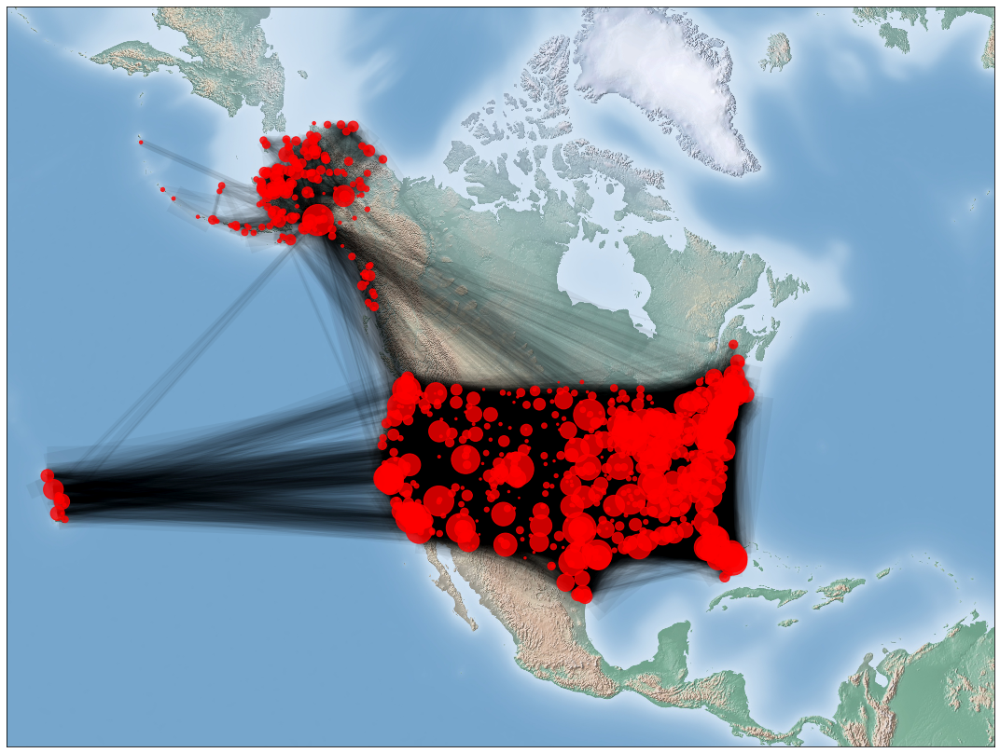

In [101]:
plt.figure(figsize=(15,20))
# m = Basemap(width=12000000,height=9000000,projection='lcc',
#             resolution=None,lat_1=45.,lat_2=55,lat_0=50,lon_0=-107.)
m = Basemap(width=12000000,height=9000000,projection='lcc',
            resolution='l',lat_1=45.,lat_2=55,lat_0=50,lon_0=-107.,suppress_ticks=True)

# import long lat as m attribute
mx, my = m(pos_data['Long'].values, pos_data['Lat'].values)
pos = {}
for count, elem in enumerate (pos_data['IATA']):
    pos[elem] = (mx[count], my[count])
# draw nodes and edges and over aly on basemap
nx.draw_networkx_nodes(G = graph, pos = pos, node_list = graph.nodes(), node_color = 'r', alpha = 0.8,
                       node_size = [counts['total_flight'][s]*3 for s in graph.nodes()])
nx.draw_networkx_edges(G = graph, pos = pos, edge_color='black', width = routes_data['counts']*0.75, 
                       alpha=0.05, arrows = False)
# m.drawcountries(linewidth = 2)
# m.drawstates(linewidth = 0.2)
# m.drawcoastlines(linewidth=3)
# # draw coastlines.
# # m.drawcoastlines()
# # draw a boundary around the map, fill the background.
# # this background will end up being the ocean color, since
# # the continents will be drawn on top.
# m.drawmapboundary(fill_color='aqua')
# fill continents, set lake color same as ocean color.
# m.fillcontinents(color='yellow',lake_color='aqua',alpha=0.3)
m.shadedrelief()
plt.tight_layout()
plt.show()


In [70]:
# pos_data[pos_data["IATA"]=="HKB"]
# routes_us[routes_us["Dest Airport"]=="HKB"]
# routes_us[routes_us["Source Airport"]=="HKB"]
# routes_us = routes_us[routes_us["Dest Airport"] != "HKB"]
# routes_us = routes_us[routes_us["Source Airport"] != "HKB"]

,Source Airport,Dest Airport,counts


C:\Users\likhi\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  """
C:\Users\likhi\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
C:\Users\likhi\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.


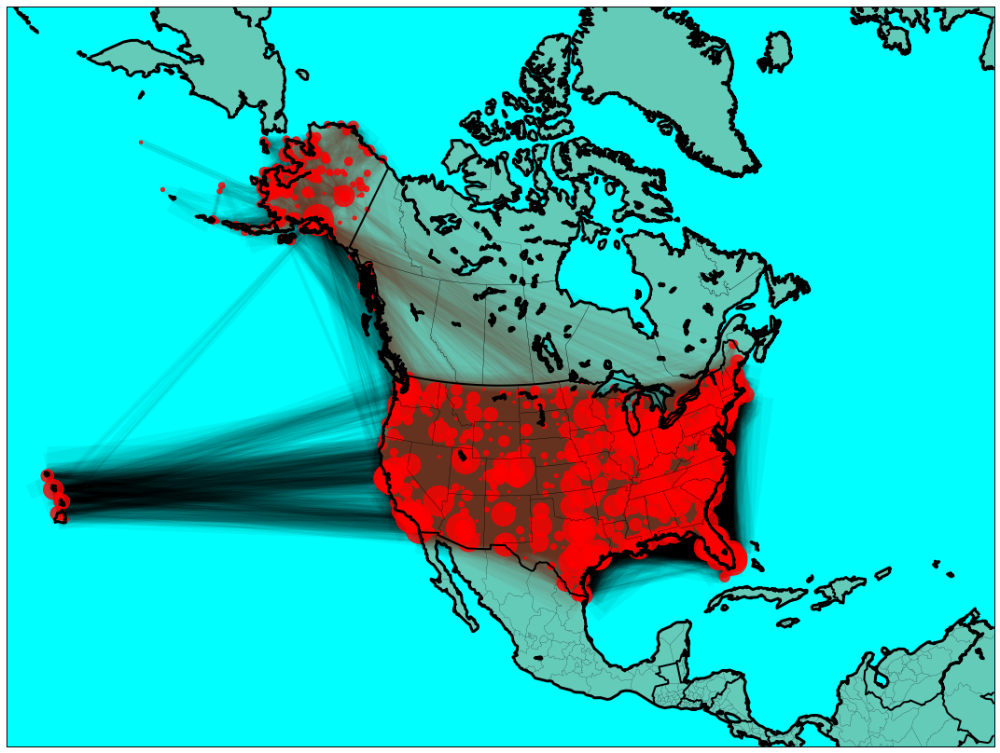

In [102]:
plt.figure(figsize=(15,20))
# m = Basemap(width=12000000,height=9000000,projection='lcc',
#             resolution=None,lat_1=45.,lat_2=55,lat_0=50,lon_0=-107.)
m = Basemap(width=12000000,height=9000000,projection='lcc',
            resolution='l',lat_1=45.,lat_2=55,lat_0=50,lon_0=-107.,suppress_ticks=True)

# import long lat as m attribute
mx, my = m(pos_data['Long'].values, pos_data['Lat'].values)
pos = {}
for count, elem in enumerate (pos_data['IATA']):
    pos[elem] = (mx[count], my[count])
# draw nodes and edges and over aly on basemap
nx.draw_networkx_nodes(G = graph, pos = pos, node_list = graph.nodes(), node_color = 'r', alpha = 0.8,
                       node_size = [counts['total_flight'][s]*3 for s in graph.nodes()])
nx.draw_networkx_edges(G = graph, pos = pos, edge_color='black', width = routes_data['counts']*0.75, 
                       alpha=0.05, arrows = False)
m.drawcountries(linewidth = 2)
m.drawstates(linewidth = 0.2)
m.drawcoastlines(linewidth=3)
# # draw coastlines.
# # m.drawcoastlines()
# # draw a boundary around the map, fill the background.
# # this background will end up being the ocean color, since
# # the continents will be drawn on top.
m.drawmapboundary(fill_color='aqua')
# fill continents, set lake color same as ocean color.
m.fillcontinents(color='coral',lake_color='aqua',alpha=0.4)
# m.shadedrelief()
plt.tight_layout()
plt.show()

C:\Users\likhi\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  after removing the cwd from sys.path.
C:\Users\likhi\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
C:\Users\likhi\Anaconda3\lib\site-packages\ipykernel_launcher.py:26: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.


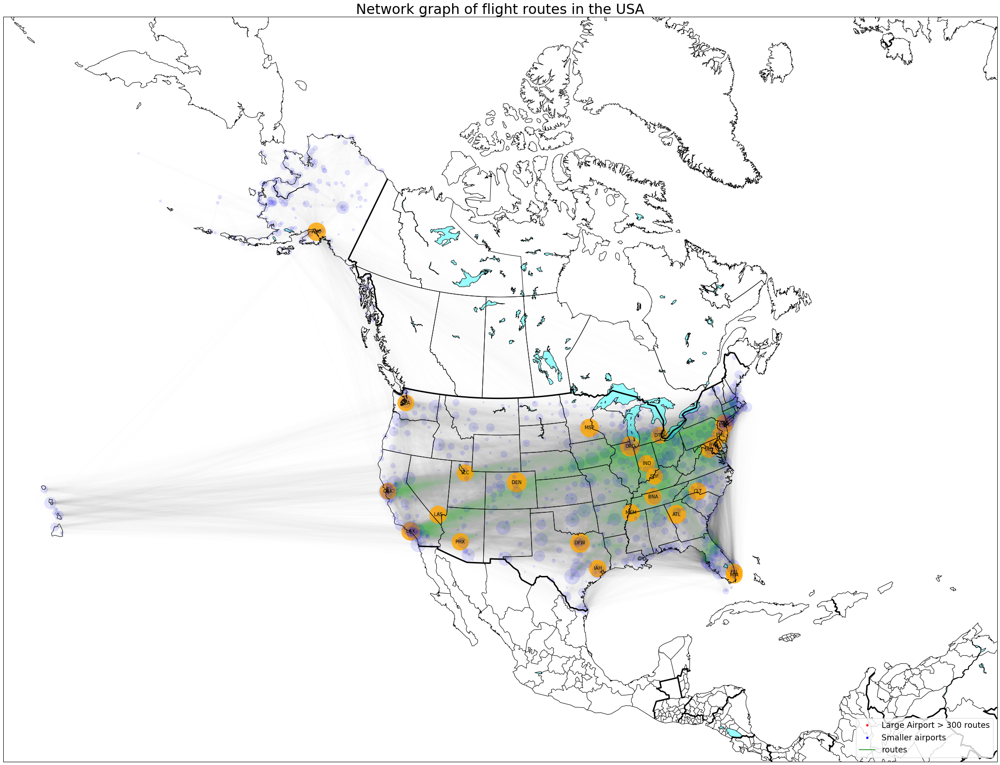

In [117]:
import matplotlib.lines as mlines
plt.figure(figsize=(30,30))
m = Basemap(width=12000000,height=9000000,projection='lcc',
            resolution='l',lat_1=45.,lat_2=55,lat_0=50,lon_0=-107.,suppress_ticks=True)
# import long lat as m attribute
mx, my = m(pos_data['Long'].values, pos_data['Lat'].values)
pos = {}
for count, elem in enumerate (pos_data['IATA']):
    pos[elem] = (mx[count], my[count])
# draw nodes and edges and overly on basemap
nx.draw_networkx_nodes(G = graph, pos = pos, nodelist = [x for x in graph.nodes() if counts['total_flight'][x] >= 300],
                       node_color = 'orange', alpha = 0.8,
                       node_size = [counts['total_flight'][x]*4  for x in graph.nodes() if counts['total_flight'][x] >= 300])

nx.draw_networkx_labels(G = graph, pos = pos, font_size=10,
                        labels = {x:x for x in graph.nodes() if counts['total_flight'][x] >= 300})

nx.draw_networkx_nodes(G = graph, pos = pos, nodelist = [x for x in graph.nodes() if counts['total_flight'][x] < 300],
                       node_color = 'b', alpha = 0.1,
                       node_size = [counts['total_flight'][x]*4  for x in graph.nodes() if counts['total_flight'][x] < 300])

nx.draw_networkx_edges(G = graph, pos = pos, edge_color = 'g', width = routes_data['counts']*0.75, 
                       alpha=0.003, arrows = False)

m.drawcountries(linewidth = 3)
m.drawstates(linewidth = 1)
m.drawcoastlines(linewidth=1)
# m.fillcontinents(alpha = 0.3)
line1 = mlines.Line2D(range(1), range(1), color="white", marker='o', markerfacecolor="red")
line2 = mlines.Line2D(range(1), range(1), color="white", marker='o',markerfacecolor="blue")
line3 = mlines.Line2D(range(1), range(1), color="green", marker='',markerfacecolor="green")
plt.legend((line1, line2, line3), ('Large Airport > 300 routes', 'Smaller airports', 'routes'),
           loc=4, fontsize = 'xx-large')
plt.title("Network graph of flight routes in the USA", fontsize = 30)
m.drawmapboundary(fill_color='white')
# fill continents, set lake color same as ocean color.
m.fillcontinents(color='white',lake_color='aqua',alpha=0.4)
#m.bluemarble()
plt.tight_layout()

C:\Users\likhi\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  after removing the cwd from sys.path.
C:\Users\likhi\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
C:\Users\likhi\Anaconda3\lib\site-packages\ipykernel_launcher.py:26: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.


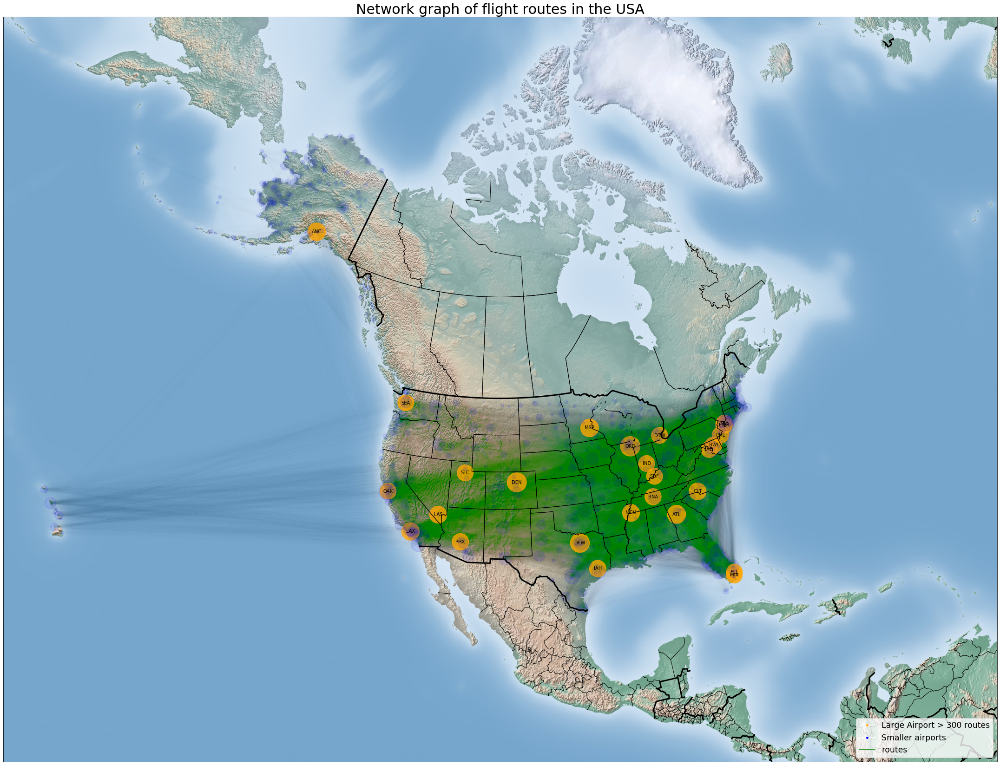

In [120]:
import matplotlib.lines as mlines
plt.figure(figsize=(30,30))
m = Basemap(width=12000000,height=9000000,projection='lcc',
            resolution='l',lat_1=45.,lat_2=55,lat_0=50,lon_0=-107.,suppress_ticks=True)
# import long lat as m attribute
mx, my = m(pos_data['Long'].values, pos_data['Lat'].values)
pos = {}
for count, elem in enumerate (pos_data['IATA']):
    pos[elem] = (mx[count], my[count])
# draw nodes and edges and overly on basemap
nx.draw_networkx_nodes(G = graph, pos = pos, nodelist = [x for x in graph.nodes() if counts['total_flight'][x] >= 300],
                       node_color = 'orange', alpha = 0.8,
                       node_size = [counts['total_flight'][x]*4  for x in graph.nodes() if counts['total_flight'][x] >= 300])

nx.draw_networkx_labels(G = graph, pos = pos, font_size=10,
                        labels = {x:x for x in graph.nodes() if counts['total_flight'][x] >= 300})

nx.draw_networkx_nodes(G = graph, pos = pos, nodelist = [x for x in graph.nodes() if counts['total_flight'][x] < 300],
                       node_color = 'b', alpha = 0.1,
                       node_size = [counts['total_flight'][x]*4  for x in graph.nodes() if counts['total_flight'][x] < 300])

nx.draw_networkx_edges(G = graph, pos = pos, edge_color = 'g', width = routes_data['counts']*0.75, 
                       alpha=0.003, arrows = False)
m.shadedrelief()
m.drawcountries(linewidth = 3)
m.drawstates(linewidth = 1)
# m.drawcoastlines(linewidth=1)
# m.fillcontinents(alpha = 0.3)
line1 = mlines.Line2D(range(1), range(1), color="white", marker='o', markerfacecolor="orange")
line2 = mlines.Line2D(range(1), range(1), color="white", marker='o',markerfacecolor="b")
line3 = mlines.Line2D(range(1), range(1), color="green", marker='',markerfacecolor="g")
plt.legend((line1, line2, line3), ('Large Airport > 300 routes', 'Smaller airports', 'routes'),
           loc=4, fontsize = 'xx-large')
plt.title("Network graph of flight routes in the USA", fontsize = 30)
# m.drawmapboundary(fill_color='white')
# fill continents, set lake color same as ocean color.
# m.fillcontinents(color='white',lake_color='aqua',alpha=0.4)
# m.shadedrelief()
#m.bluemarble()
plt.tight_layout()